In [ ]:


import numpy as np 
import matplotlib.pyplot as plt 
import matplotlib.colors as mcolors
import pandas as pd 
import random
import math
import time
from sklearn.linear_model import LinearRegression, BayesianRidge
from sklearn.model_selection import RandomizedSearchCV, train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, mean_absolute_error
import datetime
import operator 
plt.style.use('seaborn-poster')
%matplotlib inline
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('retina')
import warnings
warnings.filterwarnings("ignore")



In [ ]:
confirmed_df = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv')
deaths_df = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_global.csv')
# recoveries_df = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_recovered_global.csv')
latest_data = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_daily_reports/04-09-2022.csv')
us_medical_data = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_daily_reports_us/04-09-2022.csv')
#apple_mobility = pd.read_csv("https://covid19-static.cdn-apple.com/covid19-mobility-data/2211HotfixDev17/v3/en-us/applemobilitytrends-2022-04-09.csv")



In [ ]:
latest_data.head()

,FIPS,Admin2,Province_State,Country_Region,Last_Update,Lat,Long_,Confirmed,Deaths,Recovered,Active,Combined_Key,Incident_Rate,Case_Fatality_Ratio
0,NaN,NaN,NaN,Afghanistan,2022-04-10 04:20:52,33.93911,67.709953,177974,7671,NaN,NaN,Afghanistan,457.183624,4.310180
1,NaN,NaN,NaN,Albania,2022-04-10 04:20:52,41.15330,20.168300,274191,3492,NaN,NaN,Albania,9527.799013,1.273565
2,NaN,NaN,NaN,Algeria,2022-04-10 04:20:52,28.03390,1.659600,265720,6874,NaN,NaN,Algeria,605.960501,2.586934
3,NaN,NaN,NaN,Andorra,2022-04-10 04:20:52,42.50630,1.521800,40328,153,NaN,NaN,Andorra,52194.395910,0.379389
4,NaN,NaN,NaN,Angola,2022-04-10 04:20:52,-11.20270,17.873900,99194,1900,NaN,NaN,Angola,301.810963,1.915438


In [ ]:
confirmed_df.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,5/21/22,5/22/22,5/23/22,5/24/22,5/25/22,5/26/22,5/27/22,5/28/22,5/29/22,5/30/22
0,NaN,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,...,179674,179716,179716,179771,179835,179835,180086,180122,180174,180259
1,NaN,Albania,41.15330,20.168300,0,0,0,0,0,0,...,275838,275864,275881,275939,275985,276012,276048,276081,276101,276101
2,NaN,Algeria,28.03390,1.659600,0,0,0,0,0,0,...,265851,265854,265855,265860,265862,265864,265870,265873,265873,265877
3,NaN,Andorra,42.50630,1.521800,0,0,0,0,0,0,...,42572,42572,42572,42572,42894,42894,42894,42894,42894,42894
4,NaN,Angola,-11.20270,17.873900,0,0,0,0,0,0,...,99287,99287,99287,99433,99527,99527,99527,99527,99527,99761


In [ ]:
us_medical_data.head()

,Province_State,Country_Region,Last_Update,Lat,Long_,Confirmed,Deaths,Recovered,Active,FIPS,Incident_Rate,Total_Test_Results,People_Hospitalized,Case_Fatality_Ratio,UID,ISO3,Testing_Rate,Hospitalization_Rate
0,Alabama,US,2022-04-10 04:31:20,32.3182,-86.9023,1296730,19376,NaN,NaN,1.0,26446.687204,7492639.0,NaN,1.494220,84000001.0,USA,152811.672413,NaN
1,Alaska,US,2022-04-10 04:31:20,61.3707,-152.4044,248675,1228,NaN,NaN,2.0,33993.124141,NaN,NaN,0.493817,84000002.0,USA,NaN,NaN
2,American Samoa,US,2022-04-10 04:31:20,-14.2710,-170.1320,5018,8,NaN,NaN,60.0,9018.529502,NaN,NaN,0.159426,16.0,ASM,NaN,NaN
3,Arizona,US,2022-04-10 04:31:20,33.7298,-111.4312,2014020,29681,NaN,NaN,4.0,27669.986345,18995536.0,NaN,1.473719,84000004.0,USA,260973.685335,NaN
4,Arkansas,US,2022-04-10 04:31:20,34.9697,-92.3731,833655,11305,NaN,NaN,5.0,27624.557460,5083908.0,NaN,1.356077,84000005.0,USA,168463.823363,NaN


In [ ]:
cols = confirmed_df.keys()

In [ ]:
confirmed = confirmed_df.loc[:, cols[4]:cols[-1]]
deaths = deaths_df.loc[:, cols[4]:cols[-1]]
# recoveries = recoveries_df.loc[:, cols[4]:cols[-1]]

In [ ]:
dates = confirmed.keys()
world_cases = []
total_deaths = [] 
mortality_rate = []
# recovery_rate = [] 
# total_recovered = [] 
# total_active = [] 

for i in dates:
    confirmed_sum = confirmed[i].sum()
    death_sum = deaths[i].sum()
#     recovered_sum = recoveries[i].sum()
    
    # confirmed, deaths, recovered, and active
    world_cases.append(confirmed_sum)
    total_deaths.append(death_sum)
#     total_recovered.append(recovered_sum)
#     total_active.append(confirmed_sum-death_sum-recovered_sum)
    
    # calculate rates
    mortality_rate.append(death_sum/confirmed_sum)
#     recovery_rate.append(recovered_sum/confirmed_sum)

In [ ]:
def daily_increase(data):
    d = [] 
    for i in range(len(data)):
        if i == 0:
            d.append(data[0])
        else:
            d.append(data[i]-data[i-1])
    return d 

def moving_average(data, window_size):
    moving_average = []
    for i in range(len(data)):
        if i + window_size < len(data):
            moving_average.append(np.mean(data[i:i+window_size]))
        else:
            moving_average.append(np.mean(data[i:len(data)]))
    return moving_average

# window size
window = 7

# confirmed cases
world_daily_increase = daily_increase(world_cases)
world_confirmed_avg= moving_average(world_cases, window)
world_daily_increase_avg = moving_average(world_daily_increase, window)

# deaths
world_daily_death = daily_increase(total_deaths)
world_death_avg = moving_average(total_deaths, window)
world_daily_death_avg = moving_average(world_daily_death, window)


# recoveries
# world_daily_recovery = daily_increase(total_recovered)
# world_recovery_avg = moving_average(total_recovered, window)
# world_daily_recovery_avg = moving_average(world_daily_recovery, window)


# active 
# world_active_avg = moving_average(total_active, window)

In [ ]:
days_since_1_22 = np.array([i for i in range(len(dates))]).reshape(-1, 1)
world_cases = np.array(world_cases).reshape(-1, 1)
total_deaths = np.array(total_deaths).reshape(-1, 1)
# total_recovered = np.array(total_recovered).reshape(-1, 1)

In [ ]:
days_in_future = 10
future_forcast = np.array([i for i in range(len(dates)+days_in_future)]).reshape(-1, 1)
adjusted_dates = future_forcast[:-10]

In [ ]:
start = '1/22/2020'
start_date = datetime.datetime.strptime(start, '%m/%d/%Y')
future_forcast_dates = []
for i in range(len(future_forcast)):
    future_forcast_dates.append((start_date + datetime.timedelta(days=i)).strftime('%m/%d/%Y'))

In [ ]:
# slightly modify the data to fit the model better (regression models cannot pick the pattern)
days_to_skip = 376
X_train_confirmed, X_test_confirmed, y_train_confirmed, y_test_confirmed = train_test_split(days_since_1_22[days_to_skip:], world_cases[days_to_skip:], test_size=0.08, shuffle=False) 

In [ ]:
# # use this to find the optimal parameters for SVR
# c = [0.01, 0.1, 1]
# gamma = [0.01, 0.1, 1]
# epsilon = [0.01, 0.1, 1]
# shrinking = [True, False]

# svm_grid = {'C': c, 'gamma' : gamma, 'epsilon': epsilon, 'shrinking' : shrinking}

# svm = SVR(kernel='poly', degree=3)
# svm_search = RandomizedSearchCV(svm, svm_grid, scoring='neg_mean_squared_error', cv=3, return_train_score=True, n_jobs=-1, n_iter=30, verbose=1)
# svm_search.fit(X_train_confirmed, y_train_confirmed)

In [ ]:
# svm_confirmed = svm_search.best_estimator_
svm_confirmed = SVR(shrinking=True, kernel='poly',gamma=0.01, epsilon=1,degree=3, C=0.1)
svm_confirmed.fit(X_train_confirmed, y_train_confirmed)
svm_pred = svm_confirmed.predict(future_forcast)

MAE: 13656135.140720535
MSE: 284188420844877.7


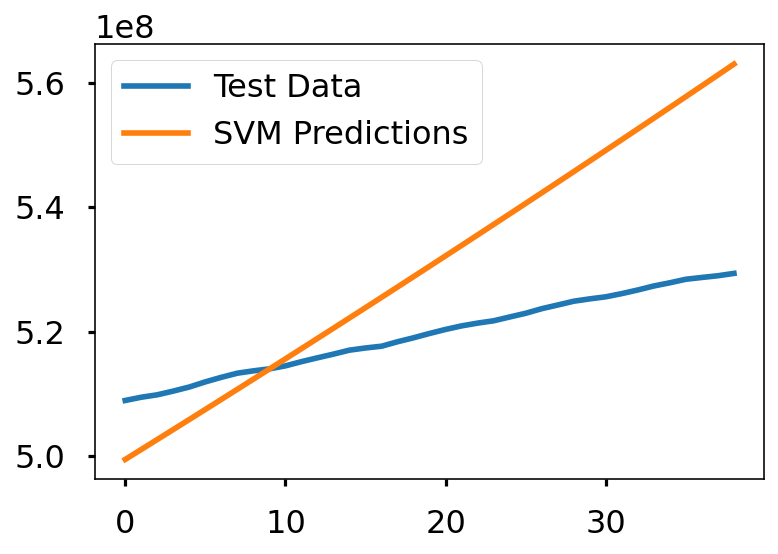

In [ ]:
# check against testing data
svm_test_pred = svm_confirmed.predict(X_test_confirmed)
plt.plot(y_test_confirmed)
plt.plot(svm_test_pred)
plt.legend(['Test Data', 'SVM Predictions'])
print('MAE:', mean_absolute_error(svm_test_pred, y_test_confirmed))
print('MSE:',mean_squared_error(svm_test_pred, y_test_confirmed))

In [ ]:
# transform our data for polynomial regression
poly = PolynomialFeatures(degree=2)
poly_X_train_confirmed = poly.fit_transform(X_train_confirmed)
poly_X_test_confirmed = poly.fit_transform(X_test_confirmed)
poly_future_forcast = poly.fit_transform(future_forcast)

bayesian_poly = PolynomialFeatures(degree=2)
bayesian_poly_X_train_confirmed = bayesian_poly.fit_transform(X_train_confirmed)
bayesian_poly_X_test_confirmed = bayesian_poly.fit_transform(X_test_confirmed)
bayesian_poly_future_forcast = bayesian_poly.fit_transform(future_forcast)

In [ ]:
# polynomial regression
linear_model = LinearRegression(normalize=True, fit_intercept=False)
linear_model.fit(poly_X_train_confirmed, y_train_confirmed)
test_linear_pred = linear_model.predict(poly_X_test_confirmed)
linear_pred = linear_model.predict(poly_future_forcast)
print('MAE:', mean_absolute_error(test_linear_pred, y_test_confirmed))
print('MSE:',mean_squared_error(test_linear_pred, y_test_confirmed))

MAE: 20208047.676389992
MSE: 601824897195681.6


In [ ]:
print(linear_model.coef_)

[[ 4.55534056e+08 -1.64175469e+06  2.07289322e+03]]


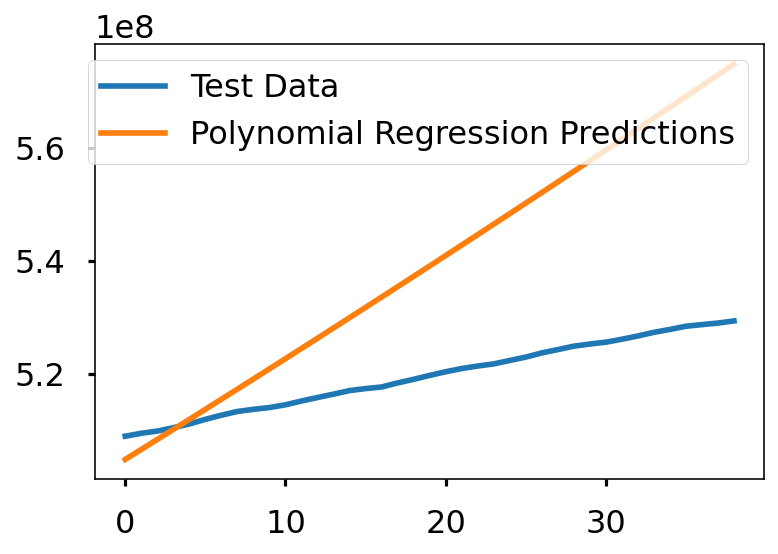

In [ ]:
plt.plot(y_test_confirmed)
plt.plot(test_linear_pred)
plt.legend(['Test Data', 'Polynomial Regression Predictions'])

In [ ]:


# bayesian ridge polynomial regression
tol = [1e-6, 1e-5, 1e-4, 1e-3, 1e-2]
alpha_1 = [1e-7, 1e-6, 1e-5, 1e-4, 1e-3]
alpha_2 = [1e-7, 1e-6, 1e-5, 1e-4, 1e-3]
lambda_1 = [1e-7, 1e-6, 1e-5, 1e-4, 1e-3]
lambda_2 = [1e-7, 1e-6, 1e-5, 1e-4, 1e-3]
normalize = [True, False]

bayesian_grid = {'tol': tol, 'alpha_1': alpha_1, 'alpha_2' : alpha_2, 'lambda_1': lambda_1, 'lambda_2' : lambda_2, 
                 'normalize' : normalize}

bayesian = BayesianRidge(fit_intercept=False)
bayesian_search = RandomizedSearchCV(bayesian, bayesian_grid, scoring='neg_mean_squared_error', cv=3, return_train_score=True, n_jobs=-1, n_iter=40, verbose=1)
bayesian_search.fit(bayesian_poly_X_train_confirmed, y_train_confirmed)



Fitting 3 folds for each of 40 candidates, totalling 120 fits


RandomizedSearchCV(cv=3, estimator=BayesianRidge(fit_intercept=False),
                   n_iter=40, n_jobs=-1,
                   param_distributions={'alpha_1': [1e-07, 1e-06, 1e-05, 0.0001,
                                                    0.001],
                                        'alpha_2': [1e-07, 1e-06, 1e-05, 0.0001,
                                                    0.001],
                                        'lambda_1': [1e-07, 1e-06, 1e-05,
                                                     0.0001, 0.001],
                                        'lambda_2': [1e-07, 1e-06, 1e-05,
                                                     0.0001, 0.001],
                                        'normalize': [True, False],
                                        'tol': [1e-06, 1e-05, 0.0001, 0.001,
                                                0.01]},
                   return_train_score=True, scoring='neg_mean_squared_error',
                   verbose=1)

In [ ]:
bayesian_search.best_params_

{'alpha_1': 1e-07,
 'alpha_2': 1e-06,
 'lambda_1': 0.001,
 'lambda_2': 1e-07,
 'normalize': True,
 'tol': 0.01}

In [ ]:
bayesian_confirmed = bayesian_search.best_estimator_
test_bayesian_pred = bayesian_confirmed.predict(bayesian_poly_X_test_confirmed)
bayesian_pred = bayesian_confirmed.predict(bayesian_poly_future_forcast)
print('MAE:', mean_absolute_error(test_bayesian_pred, y_test_confirmed))
print('MSE:',mean_squared_error(test_bayesian_pred, y_test_confirmed))

MAE: 44592633.71679921
MSE: 2031446295396535.5


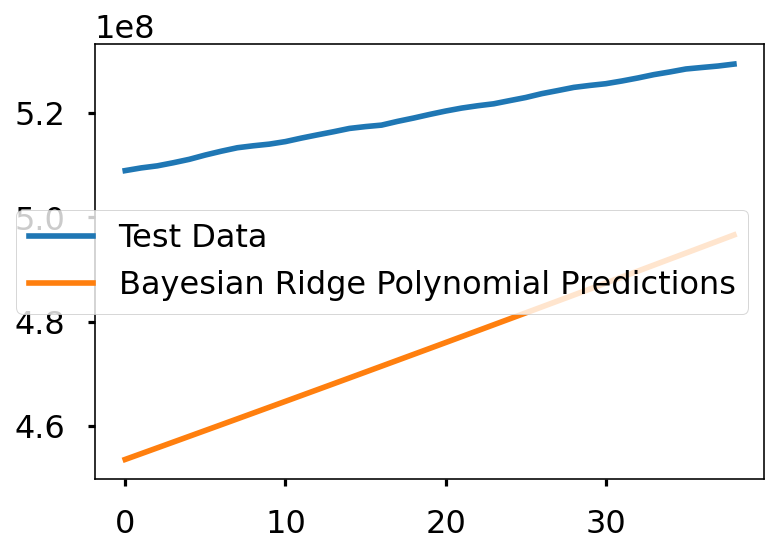

In [ ]:
plt.plot(y_test_confirmed)
plt.plot(test_bayesian_pred)
plt.legend(['Test Data', 'Bayesian Ridge Polynomial Predictions'])

In [ ]:
# helper method for flattening the data, so it can be displayed on a bar graph 
def flatten(arr):
    a = [] 
    arr = arr.tolist()
    for i in arr:
        a.append(i[0])
    return a

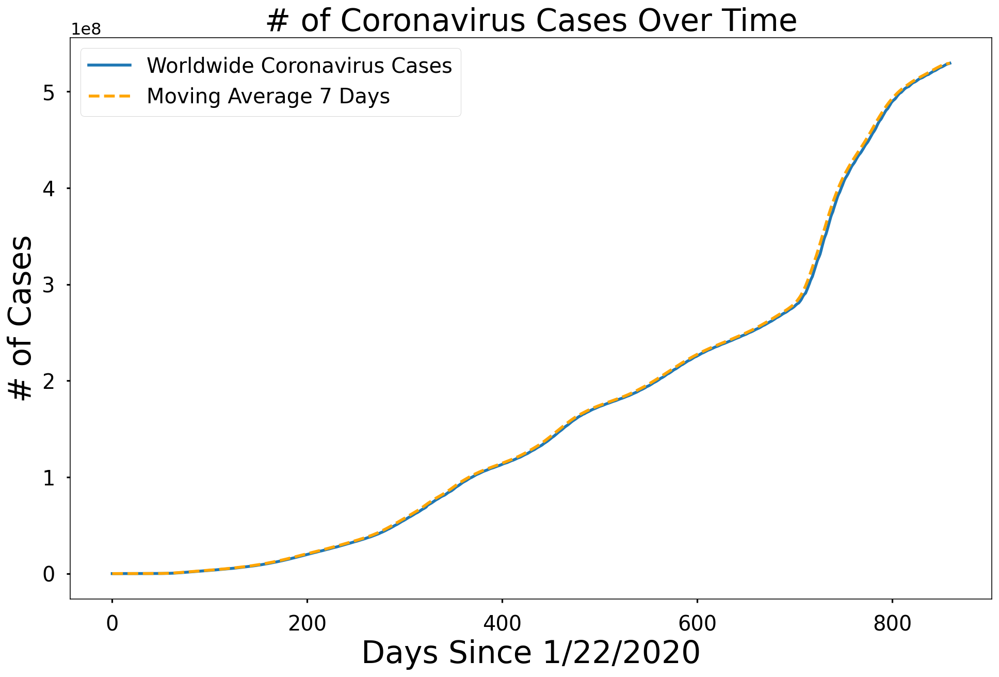

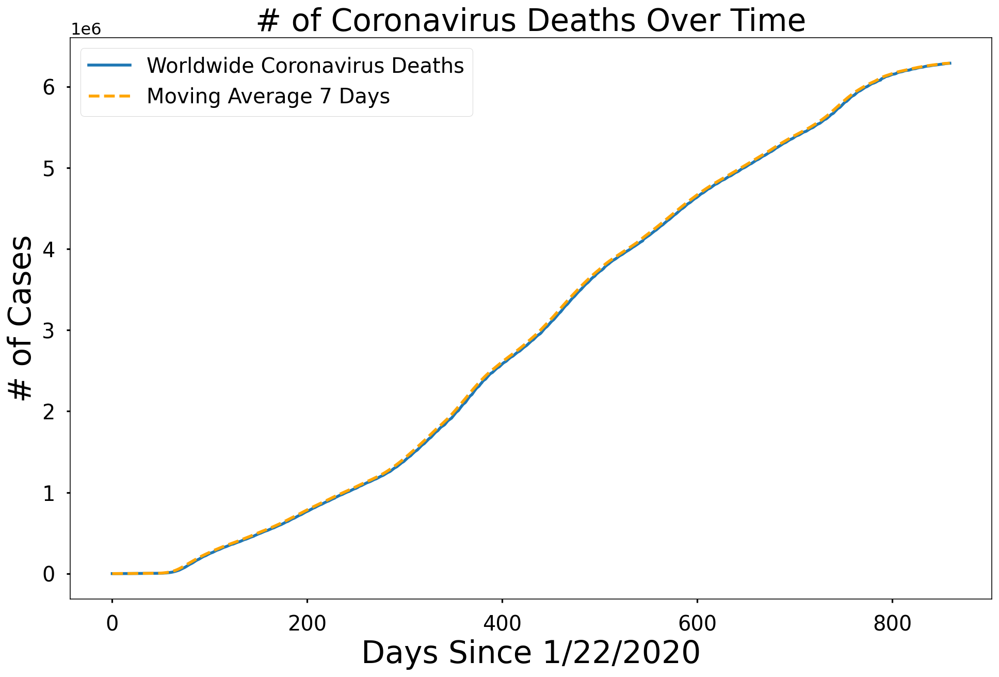

In [ ]:
adjusted_dates = adjusted_dates.reshape(1, -1)[0]
plt.figure(figsize=(16, 10))
plt.plot(adjusted_dates, world_cases)
plt.plot(adjusted_dates, world_confirmed_avg, linestyle='dashed', color='orange')
plt.title('# of Coronavirus Cases Over Time', size=30)
plt.xlabel('Days Since 1/22/2020', size=30)
plt.ylabel('# of Cases', size=30)
plt.legend(['Worldwide Coronavirus Cases', 'Moving Average {} Days'.format(window)], prop={'size': 20})
plt.xticks(size=20)
plt.yticks(size=20)
plt.show()

plt.figure(figsize=(16, 10))
plt.plot(adjusted_dates, total_deaths)
plt.plot(adjusted_dates, world_death_avg, linestyle='dashed', color='orange')
plt.title('# of Coronavirus Deaths Over Time', size=30)
plt.xlabel('Days Since 1/22/2020', size=30)
plt.ylabel('# of Cases', size=30)
plt.legend(['Worldwide Coronavirus Deaths', 'Moving Average {} Days'.format(window)], prop={'size': 20})
plt.xticks(size=20)
plt.yticks(size=20)
plt.show()

# plt.figure(figsize=(16, 10))
# plt.plot(adjusted_dates, total_recovered)
# plt.plot(adjusted_dates, world_recovery_avg, linestyle='dashed', color='orange')
# plt.title('# of Coronavirus Recoveries Over Time', size=30)
# plt.xlabel('Days Since 1/22/2020', size=30)
# plt.ylabel('# of Cases', size=30)
# plt.legend(['Worldwide Coronavirus Recoveries', 'Moving Average {} Days'.format(window)], prop={'size': 20})
# plt.xticks(size=20)
# plt.yticks(size=20)
# plt.show()

# plt.figure(figsize=(16, 10))
# plt.plot(adjusted_dates, total_active)
# plt.plot(adjusted_dates, world_active_avg, linestyle='dashed', color='orange')
# plt.title('# of Coronavirus Active Cases Over Time', size=30)
# plt.xlabel('Days Since 1/22/2020', size=30)
# plt.ylabel('# of Active Cases', size=30)
# plt.legend(['Worldwide Coronavirus Active Cases', 'Moving Average {} Days'.format(window)], prop={'size': 20})
# plt.xticks(size=20)
# plt.yticks(size=20)
# plt.show()


In [ ]:
def country_plot(x, y1, y2, y3, country):
    # window is set as 14 in in the beginning of the notebook 
    confirmed_avg = moving_average(y1, window)
    confirmed_increase_avg = moving_average(y2, window)
    death_increase_avg = moving_average(y3, window)
#     recovery_increase_avg = moving_average(y4, window)
    
    plt.figure(figsize=(16, 10))
    plt.plot(x, y1)
    plt.plot(x, confirmed_avg, color='red', linestyle='dashed')
    plt.legend(['{} Confirmed Cases'.format(country), 'Moving Average {} Days'.format(window)], prop={'size': 20})
    plt.title('{} Confirmed Cases'.format(country), size=30)
    plt.xlabel('Days Since 1/22/2020', size=30)
    plt.ylabel('# of Cases', size=30)
    plt.xticks(size=20)
    plt.yticks(size=20)
    plt.show()

    plt.figure(figsize=(16, 10))
    plt.bar(x, y2)
    plt.plot(x, confirmed_increase_avg, color='red', linestyle='dashed')
    plt.legend(['Moving Average {} Days'.format(window), '{} Daily Increase in Confirmed Cases'.format(country)], prop={'size': 20})
    plt.title('{} Daily Increases in Confirmed Cases'.format(country), size=30)
    plt.xlabel('Days Since 1/22/2020', size=30)
    plt.ylabel('# of Cases', size=30)
    plt.xticks(size=20)
    plt.yticks(size=20)
    plt.show()

    plt.figure(figsize=(16, 10))
    plt.bar(x, y3)
    plt.plot(x, death_increase_avg, color='red', linestyle='dashed')
    plt.legend(['Moving Average {} Days'.format(window), '{} Daily Increase in Confirmed Deaths'.format(country)], prop={'size': 20})
    plt.title('{} Daily Increases in Deaths'.format(country), size=30)
    plt.xlabel('Days Since 1/22/2020', size=30)
    plt.ylabel('# of Cases', size=30)
    plt.xticks(size=20)
    plt.yticks(size=20)
    plt.show()

#     plt.figure(figsize=(16, 10))
#     plt.bar(x, y4)
#     plt.plot(x, recovery_increase_avg, color='red', linestyle='dashed')
#     plt.legend(['Moving Average {} Days'.format(window), '{} Daily Increase in Confirmed Recoveries'.format(country)], prop={'size': 20})
#     plt.title('{} Daily Increases in Recoveries'.format(country), size=30)
#     plt.xlabel('Days Since 1/22/2020', size=30)
#     plt.ylabel('# of Cases', size=30)
#     plt.xticks(size=20)
#     plt.yticks(size=20)
#     plt.show()
      
# helper function for getting country's cases, deaths, and recoveries        
def get_country_info(country_name):
    country_cases = []
    country_deaths = []
#     country_recoveries = []  
    
    for i in dates:
        country_cases.append(confirmed_df[confirmed_df['Country/Region']==country_name][i].sum())
        country_deaths.append(deaths_df[deaths_df['Country/Region']==country_name][i].sum())
#         country_recoveries.append(recoveries_df[recoveries_df['Country/Region']==country_name][i].sum())
    return (country_cases, country_deaths)
    
    
def country_visualizations(country_name):
    country_info = get_country_info(country_name)
    country_cases = country_info[0]
    country_deaths = country_info[1]
    
    country_daily_increase = daily_increase(country_cases)
    country_daily_death = daily_increase(country_deaths)
#     country_daily_recovery = daily_increase(country_recoveries)
    
    country_plot(adjusted_dates, country_cases, country_daily_increase, country_daily_death, country_name)

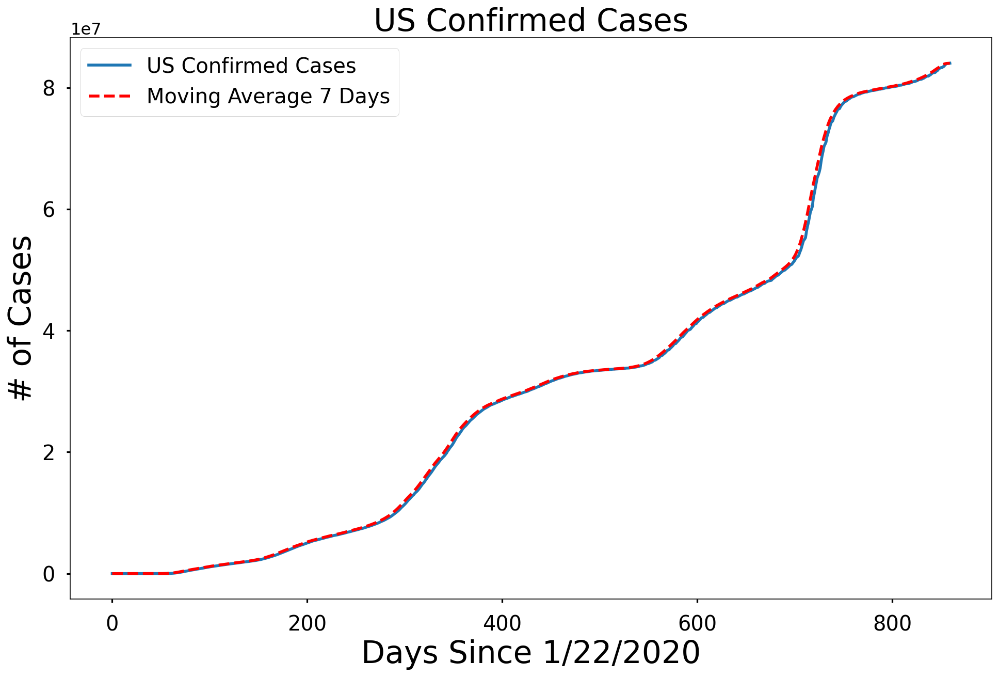

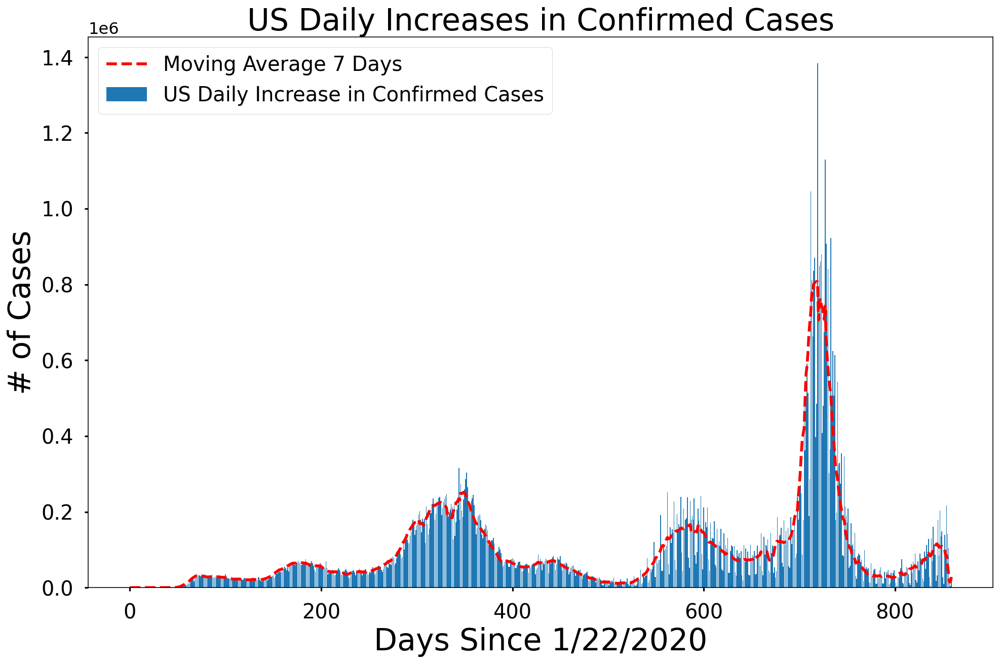

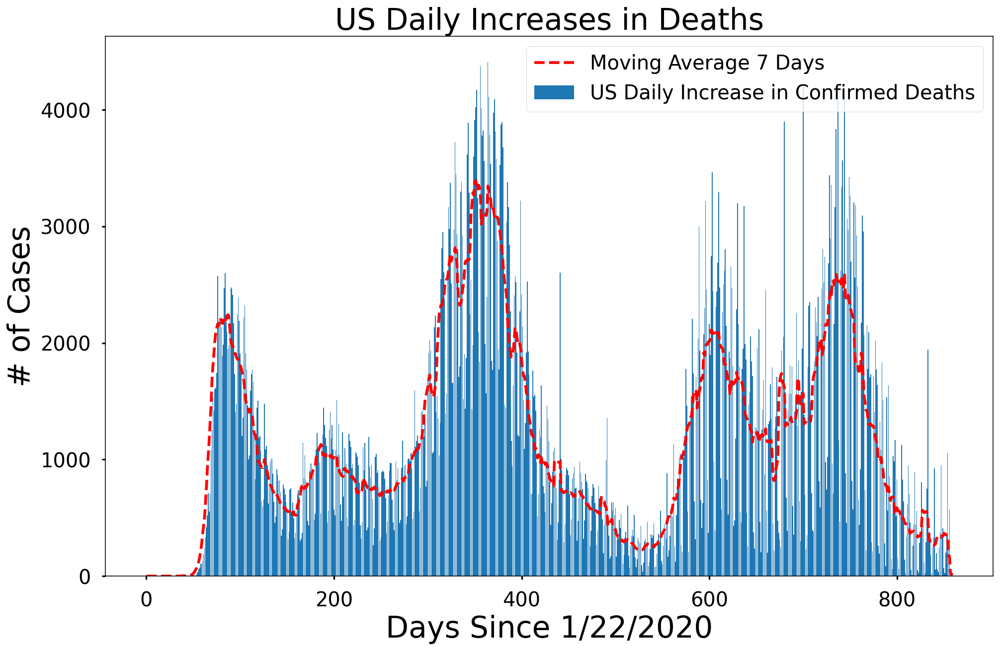

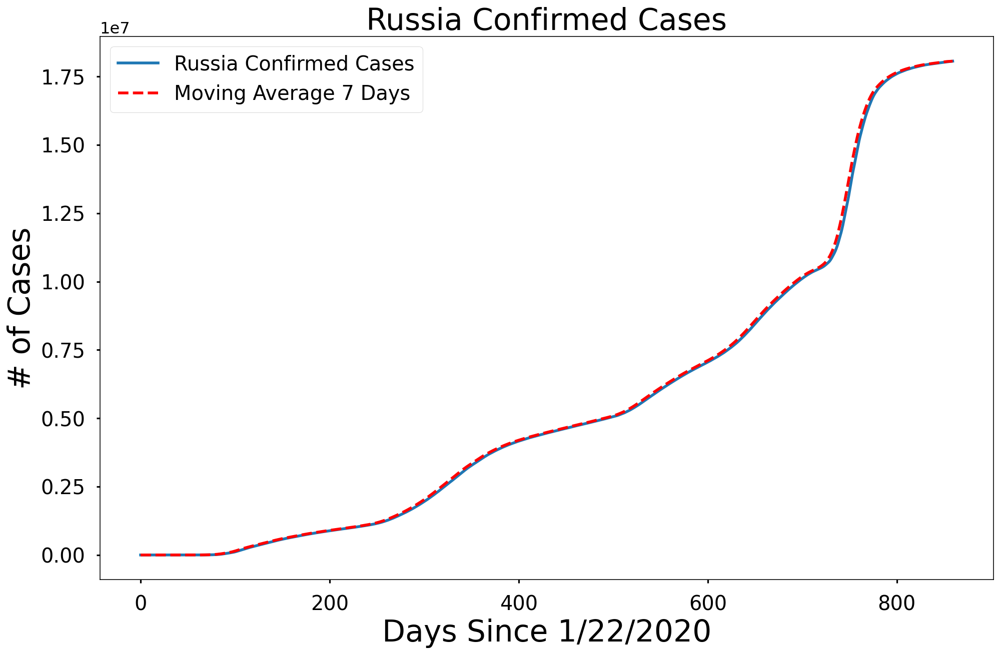

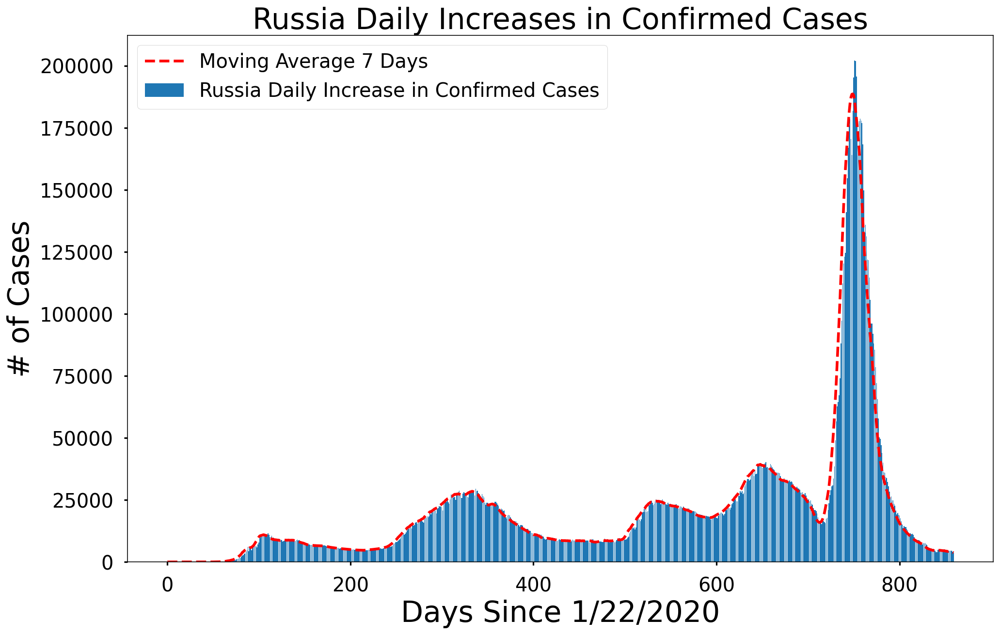

...

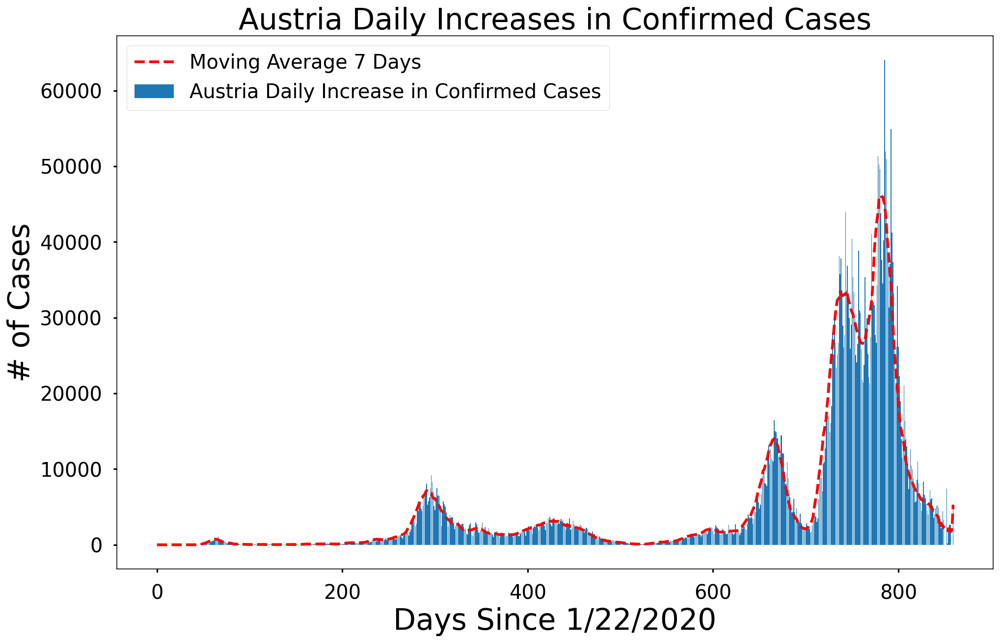

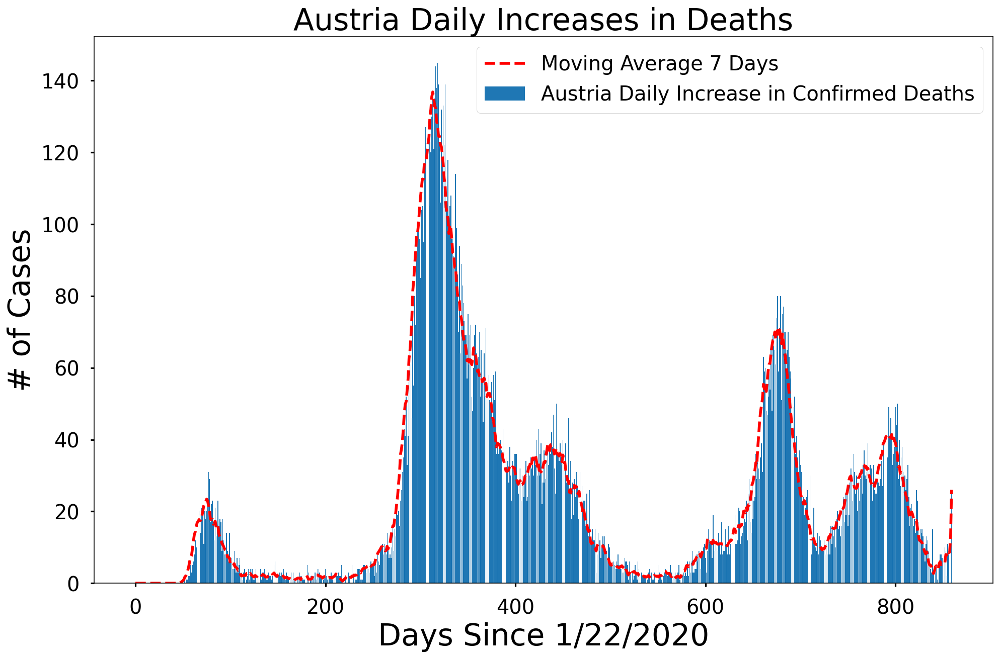

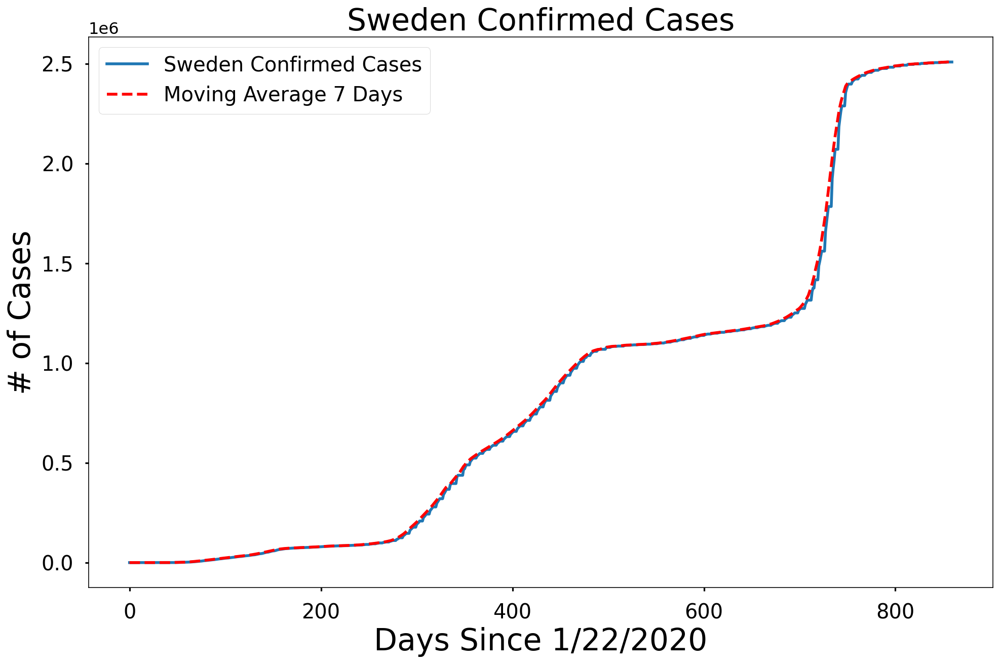

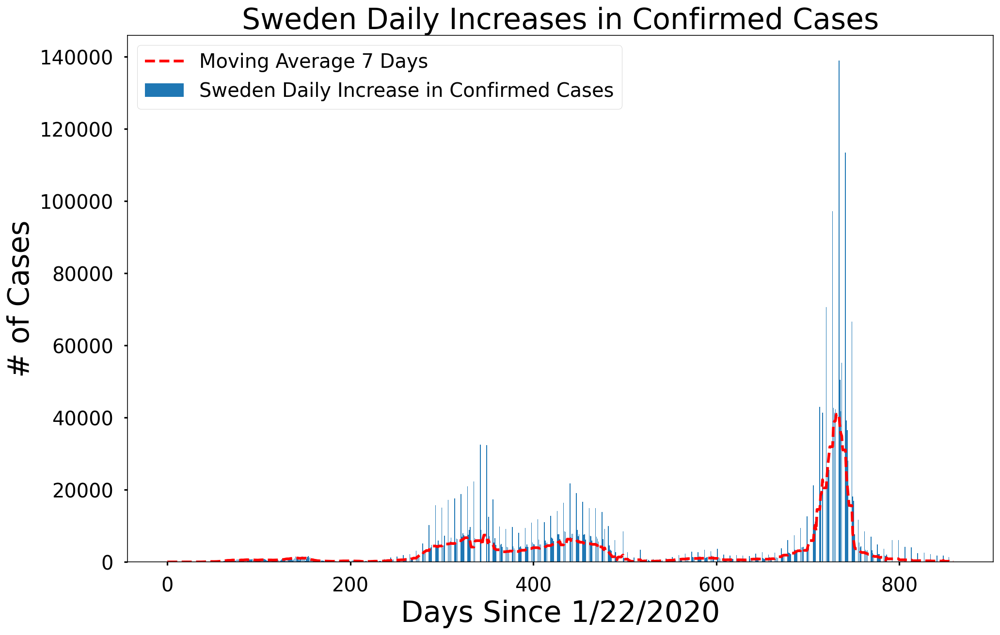

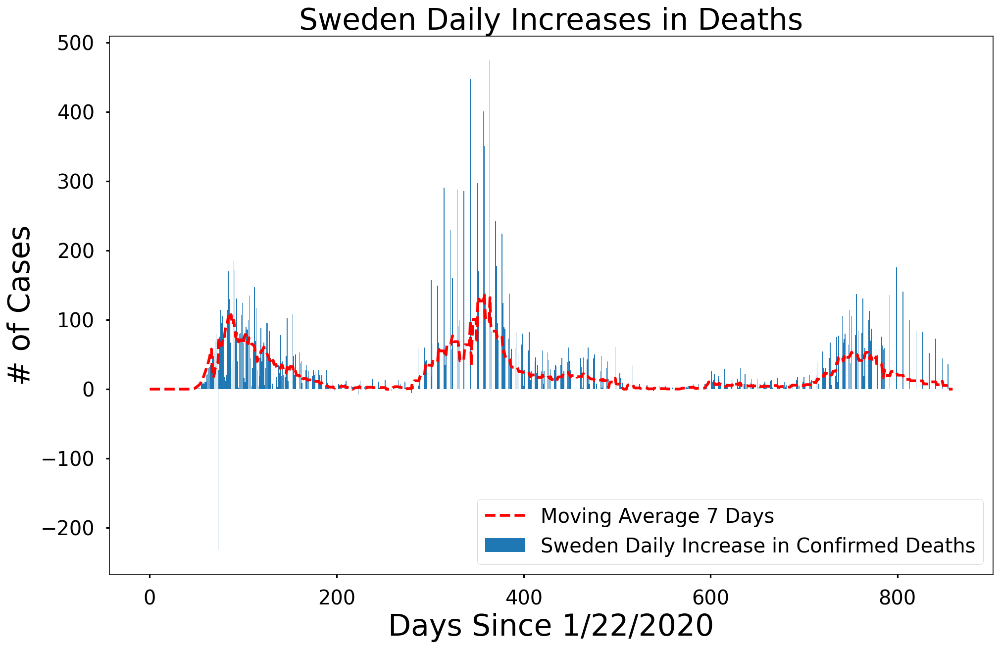

In [ ]:
countries = ['US', 'Russia', 'India', 'Brazil', 'South Africa', 'China', 'Italy',
             'Germany', 'Spain', 'France', 'United Kingdom', 'Peru', 'Mexico', 'Colombia', 'Argentina', 'Saudi Arabia', 'Iran', 'Bangladesh',
            'Pakistan', 'Turkey', 'Philippines', 'Iraq', 'Indonesia', 'Israel', 'Ukraine', 'Ecuador', 'Bolivia', 'Netherlands', 'Belgium', 'Poland', 'Czechia', 'Switzerland',
            'Romania', 'Morocco','Portugal', 'Austria', 'Sweden'] 

for country in countries:
    country_visualizations(country)

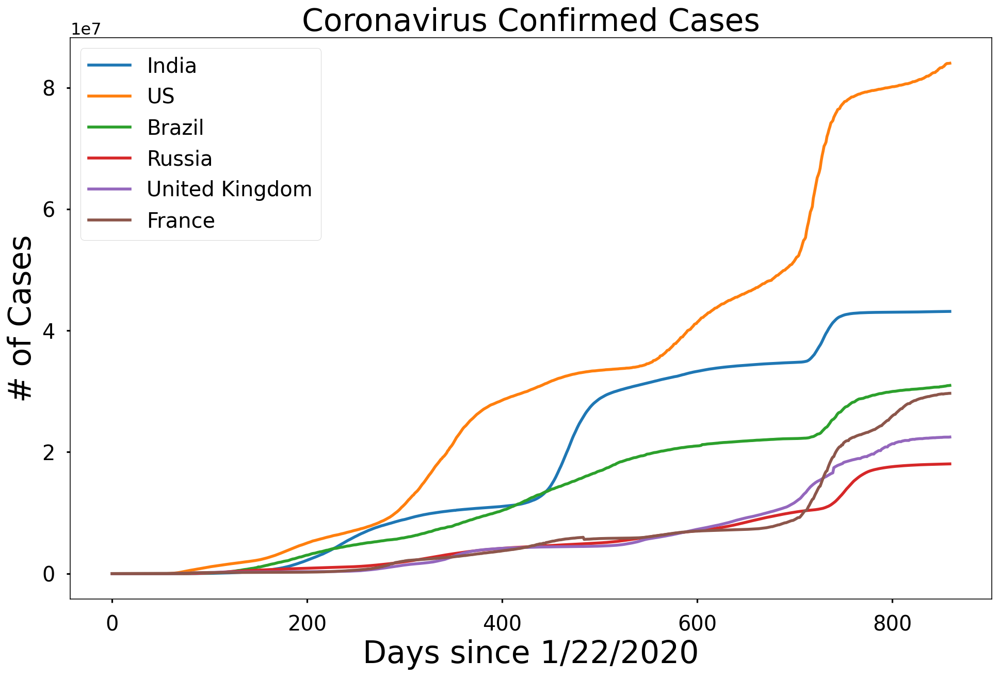

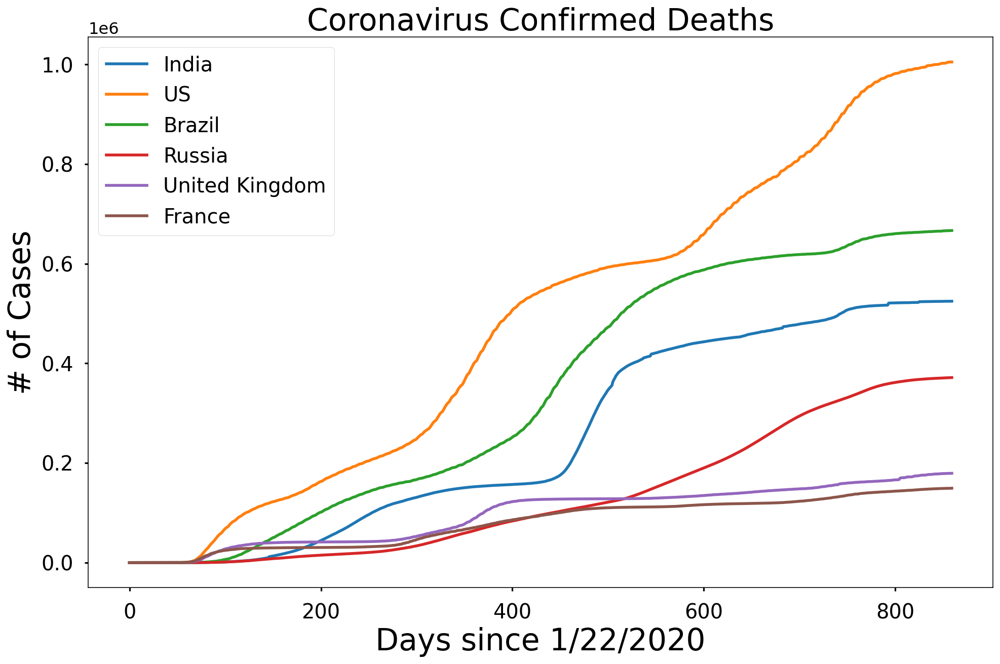

In [ ]:
# removed redundant code

compare_countries = ['India', 'US', 'Brazil', 'Russia', 'United Kingdom', 'France'] 
graph_name = ['Coronavirus Confirmed Cases', 'Coronavirus Confirmed Deaths']

for num in range(2):
    plt.figure(figsize=(16, 10))
    for country in compare_countries:
        plt.plot(get_country_info(country)[num])
    plt.legend(compare_countries, prop={'size': 20})
    plt.xlabel('Days since 1/22/2020', size=30)
    plt.ylabel('# of Cases', size=30)
    plt.title(graph_name[num], size=30)
    plt.xticks(size=20)
    plt.yticks(size=20)
    plt.show()

In [ ]:
def plot_predictions(x, y, pred, algo_name, color):
    plt.figure(figsize=(16, 10))
    plt.plot(x, y)
    plt.plot(future_forcast, pred, linestyle='dashed', color=color)
    plt.title('Worldwide Coronavirus Cases Over Time', size=30)
    plt.xlabel('Days Since 1/22/2020', size=30)
    plt.ylabel('# of Cases', size=30)
    plt.legend(['Confirmed Cases', algo_name], prop={'size': 20})
    plt.xticks(size=20)
    plt.yticks(size=20)
    plt.show()

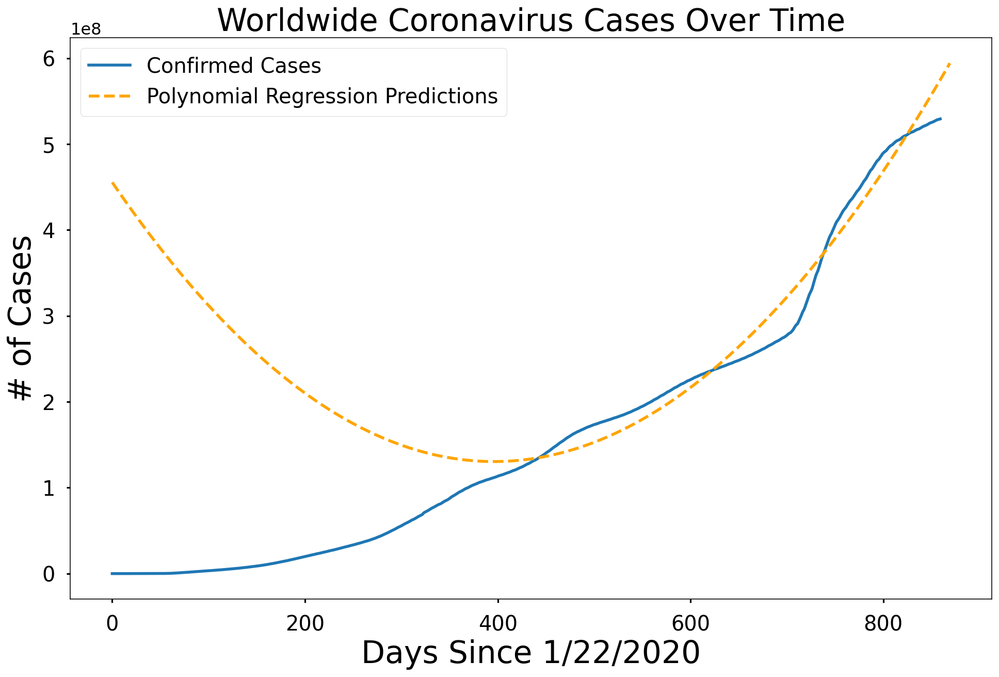

In [ ]:
plot_predictions(adjusted_dates, world_cases, linear_pred, 'Polynomial Regression Predictions', 'orange')

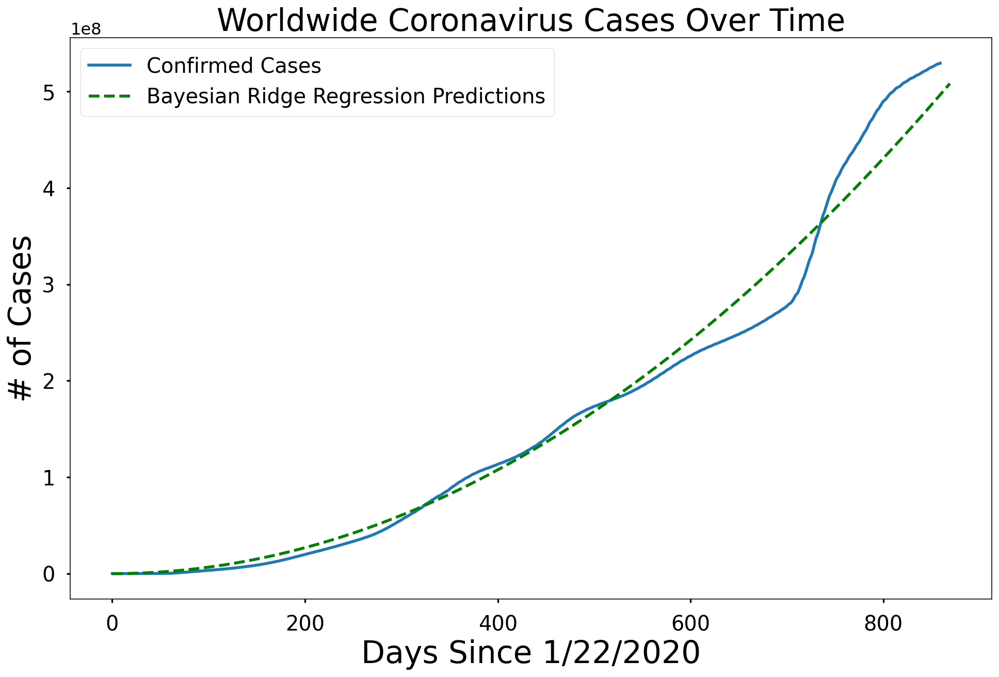

In [ ]:
plot_predictions(adjusted_dates, world_cases, bayesian_pred, 'Bayesian Ridge Regression Predictions', 'green')

In [ ]:
# Future predictions using SVM 
svm_df = pd.DataFrame({'Date': future_forcast_dates[-10:], 'SVM Predicted # of Confirmed Cases Worldwide': np.round(svm_pred[-10:])})
svm_df.style.background_gradient(cmap='Reds')

,Date,SVM Predicted # of Confirmed Cases Worldwide
0,05/31/2022,564720356.000000
1,06/01/2022,566472605.000000
2,06/02/2022,568228929.000000
3,06/03/2022,569989332.000000
4,06/04/2022,571753820.000000
5,06/05/2022,573522398.000000
6,06/06/2022,575295069.000000
7,06/07/2022,577071839.000000
8,06/08/2022,578852712.000000
9,06/09/2022,580637694.000000


In [ ]:
# Future predictions using polynomial regression
linear_pred = linear_pred.reshape(1,-1)[0]
linear_df = pd.DataFrame({'Date': future_forcast_dates[-10:], 'Polynomial Predicted # of Confirmed Cases Worldwide': np.round(linear_pred[-10:])})
linear_df.style.background_gradient(cmap='Reds')


,Date,Polynomial Predicted # of Confirmed Cases Worldwide
0,05/31/2022,576736845.000000
1,06/01/2022,578662539.000000
2,06/02/2022,580592379.000000
3,06/03/2022,582526366.000000
4,06/04/2022,584464497.000000
5,06/05/2022,586406775.000000
6,06/06/2022,588353199.000000
7,06/07/2022,590303768.000000
8,06/08/2022,592258483.000000
9,06/09/2022,594217344.000000


In [ ]:
# Future predictions using Bayesian Ridge 
bayesian_df = pd.DataFrame({'Date': future_forcast_dates[-10:], 'Bayesian Ridge Predicted # of Confirmed Cases Worldwide': np.round(bayesian_pred[-10:])})
bayesian_df.style.background_gradient(cmap='Reds')


,Date,Bayesian Ridge Predicted # of Confirmed Cases Worldwide
0,05/31/2022,497809363.000000
1,06/01/2022,498967997.000000
2,06/02/2022,500127977.000000
3,06/03/2022,501289304.000000
4,06/04/2022,502451978.000000
5,06/05/2022,503615998.000000
6,06/06/2022,504781365.000000
7,06/07/2022,505948080.000000
8,06/08/2022,507116140.000000
9,06/09/2022,508285548.000000


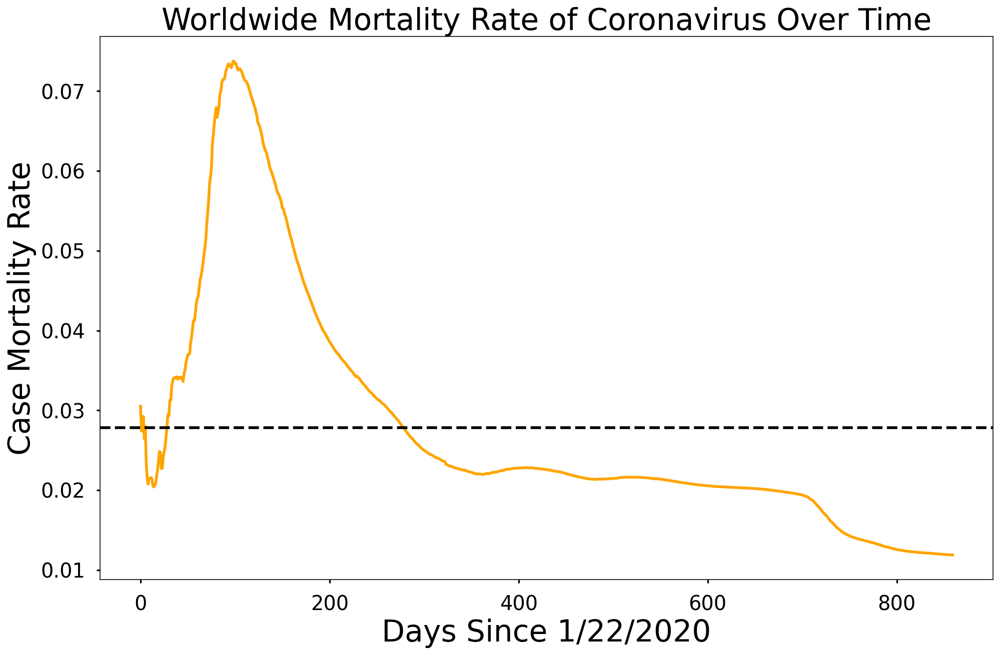

In [ ]:
mean_mortality_rate = np.mean(mortality_rate)
plt.figure(figsize=(16, 10))
plt.plot(adjusted_dates, mortality_rate, color='orange')
plt.axhline(y = mean_mortality_rate,linestyle='--', color='black')
plt.title('Worldwide Mortality Rate of Coronavirus Over Time', size=30)
plt.xlabel('Days Since 1/22/2020', size=30)
plt.ylabel('Case Mortality Rate', size=30)
plt.xticks(size=20)
plt.yticks(size=20)
plt.show()

In [ ]:
latest_data

,FIPS,Admin2,Province_State,Country_Region,Last_Update,Lat,Long_,Confirmed,Deaths,Recovered,Active,Combined_Key,Incident_Rate,Case_Fatality_Ratio
0,NaN,NaN,NaN,Afghanistan,2022-04-10 04:20:52,33.939110,67.709953,177974,7671,NaN,NaN,Afghanistan,457.183624,4.310180
1,NaN,NaN,NaN,Albania,2022-04-10 04:20:52,41.153300,20.168300,274191,3492,NaN,NaN,Albania,9527.799013,1.273565
2,NaN,NaN,NaN,Algeria,2022-04-10 04:20:52,28.033900,1.659600,265720,6874,NaN,NaN,Algeria,605.960501,2.586934
3,NaN,NaN,NaN,Andorra,2022-04-10 04:20:52,42.506300,1.521800,40328,153,NaN,NaN,Andorra,52194.395910,0.379389
4,NaN,NaN,NaN,Angola,2022-04-10 04:20:52,-11.202700,17.873900,99194,1900,NaN,NaN,Angola,301.810963,1.915438
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4006,NaN,NaN,NaN,Winter Olympics 2022,2022-04-10 04:20:52,39.904200,116.407400,535,0,NaN,NaN,Winter Olympics 2022,NaN,0.000000
4007,NaN,NaN,NaN,Yemen,2022-04-10 04:20:52,15.552727,48.516388,11813,2147,NaN,NaN,Yemen,39.606426,18.174892
4008,NaN,NaN,NaN,Zambia,2022-04-10 04:20:52,-13.133897,27.849332,317483,3967,NaN,NaN,Zambia,1726.956918,1.249516
4009,NaN,NaN,NaN,Zimbabwe,2022-04-10 04:20:52,-19.015438,29.154857,246925,5457,NaN,NaN,Zimbabwe,1661.348401,2.209983


In [ ]:
unique_countries =  list(latest_data['Country_Region'].unique())

In [ ]:
country_confirmed_cases = []
country_death_cases = [] 
country_active_cases = []
# country_recovery_cases = []
country_incidence_rate = [] 
country_mortality_rate = [] 

no_cases = []
for i in unique_countries:
    cases = latest_data[latest_data['Country_Region']==i]['Confirmed'].sum()
    if cases > 0:
        country_confirmed_cases.append(cases)
    else:
        no_cases.append(i)
        
for i in no_cases:
    unique_countries.remove(i)
    
# sort countries by the number of confirmed cases
unique_countries = [k for k, v in sorted(zip(unique_countries, country_confirmed_cases), key=operator.itemgetter(1), reverse=True)]
for i in range(len(unique_countries)):
    country_confirmed_cases[i] = latest_data[latest_data['Country_Region']==unique_countries[i]]['Confirmed'].sum()
    country_death_cases.append(latest_data[latest_data['Country_Region']==unique_countries[i]]['Deaths'].sum())
#     country_recovery_cases.append(latest_data[latest_data['Country_Region']==unique_countries[i]]['Recovered'].sum())
#     country_active_cases.append(latest_data[latest_data['Country_Region']==unique_countries[i]]['Active'].sum())
    country_incidence_rate.append(latest_data[latest_data['Country_Region']==unique_countries[i]]['Incident_Rate'].sum())
    country_mortality_rate.append(country_death_cases[i]/country_confirmed_cases[i])


In [ ]:
country_df = pd.DataFrame({'Country Name': unique_countries, 'Number of Confirmed Cases': [format(int(i), ',d') for i in country_confirmed_cases],
                          'Number of Deaths': [format(int(i), ',d') for i in country_death_cases], 
                          'Incidence Rate' : country_incidence_rate,
                          'Mortality Rate': country_mortality_rate})
# number of cases per country/region

country_df.style.background_gradient(cmap='Oranges')

,Country Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,US,"80,393,928","985,859",77707993.478704,0.012263
1,India,"43,035,271","521,685",193036.225154,0.012122
2,Brazil,"30,146,769","661,475",437873.394195,0.021942
3,France,"27,029,271","144,280",356429.638640,0.005338
4,Germany,"22,647,197","131,715",430296.317133,0.005816
5,United Kingdom,"21,716,180","170,367",410034.660243,0.007845
6,Russia,"17,720,977","364,011",1012583.965948,0.020541
7,"Korea, South","15,333,670","19,421",29908.161400,0.001267
8,Italy,"15,238,128","160,658",527434.463447,0.010543
9,Turkey,"14,953,365","98,377",17730.057412,0.006579


In [ ]:
unique_provinces =  list(latest_data['Province_State'].unique())

In [ ]:
province_confirmed_cases = []
province_country = [] 
province_death_cases = [] 
# province_recovery_cases = []
# province_active = [] 
province_incidence_rate = []
province_mortality_rate = [] 

no_cases = [] 
for i in unique_provinces:
    cases = latest_data[latest_data['Province_State']==i]['Confirmed'].sum()
    if cases > 0:
        province_confirmed_cases.append(cases)
    else:
        no_cases.append(i)
 
# remove areas with no confirmed cases
for i in no_cases:
    unique_provinces.remove(i)
    
unique_provinces = [k for k, v in sorted(zip(unique_provinces, province_confirmed_cases), key=operator.itemgetter(1), reverse=True)]
for i in range(len(unique_provinces)):
    province_confirmed_cases[i] = latest_data[latest_data['Province_State']==unique_provinces[i]]['Confirmed'].sum()
    province_country.append(latest_data[latest_data['Province_State']==unique_provinces[i]]['Country_Region'].unique()[0])
    province_death_cases.append(latest_data[latest_data['Province_State']==unique_provinces[i]]['Deaths'].sum())
#     province_recovery_cases.append(latest_data[latest_data['Province_State']==unique_provinces[i]]['Recovered'].sum())
#     province_active.append(latest_data[latest_data['Province_State']==unique_provinces[i]]['Active'].sum())
    province_incidence_rate.append(latest_data[latest_data['Province_State']==unique_provinces[i]]['Incident_Rate'].sum())
    province_mortality_rate.append(province_death_cases[i]/province_confirmed_cases[i])

In [ ]:
# number of cases per province/state/city top 100 
province_limit = 100 
province_df = pd.DataFrame({'Province/State Name': unique_provinces[:province_limit], 'Country': province_country[:province_limit], 'Number of Confirmed Cases': [format(int(i), ',d') for i in province_confirmed_cases[:province_limit]],
                          'Number of Deaths': [format(int(i), ',d') for i in province_death_cases[:province_limit]], 
                        'Incidence Rate' : province_incidence_rate[:province_limit], 'Mortality Rate': province_mortality_rate[:province_limit]})
# number of cases per country/region

province_df.style.background_gradient(cmap='Oranges')



,Province/State Name,Country,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,England,United Kingdom,"18,142,371","147,539",32410.286688,0.008132
1,California,US,"9,136,490","89,246",1203453.393873,0.009768
2,Maharashtra,India,"7,875,080","147,816",6395.005635,0.018770
3,Texas,US,"6,771,213","87,711",5945071.105206,0.012954
4,Kerala,India,"6,535,704","68,360",18307.579757,0.010459
5,Florida,US,"5,906,352","73,555",1722213.532116,0.012454
6,Sao Paulo,Brazil,"5,306,969","167,706",11557.227590,0.031601
7,New York,US,"5,033,233","68,048",1355589.195285,0.013520
8,Nordrhein-Westfalen,Germany,"4,517,864","24,034",25193.508757,0.005320
9,Bayern,Germany,"4,295,286","22,948",32846.812286,0.005343


In [ ]:
# return the data table with province/state info for a given country
def country_table(country_name):
    states = list(latest_data[latest_data['Country_Region']==country_name]['Province_State'].unique())
    state_confirmed_cases = []
    state_death_cases = [] 
    # state_recovery_cases = []
#     state_active = [] 
    state_incidence_rate = [] 
    state_mortality_rate = [] 

    no_cases = [] 
    for i in states:
        cases = latest_data[latest_data['Province_State']==i]['Confirmed'].sum()
        if cases > 0:
            state_confirmed_cases.append(cases)
        else:
            no_cases.append(i)

    # remove areas with no confirmed cases
    for i in no_cases:
        states.remove(i)

    states = [k for k, v in sorted(zip(states, state_confirmed_cases), key=operator.itemgetter(1), reverse=True)]
    for i in range(len(states)):
        state_confirmed_cases[i] = latest_data[latest_data['Province_State']==states[i]]['Confirmed'].sum()
        state_death_cases.append(latest_data[latest_data['Province_State']==states[i]]['Deaths'].sum())
    #     state_recovery_cases.append(latest_data[latest_data['Province_State']==states[i]]['Recovered'].sum())
#         state_active.append(latest_data[latest_data['Province_State']==states[i]]['Active'].sum())
        state_incidence_rate.append(latest_data[latest_data['Province_State']==states[i]]['Incident_Rate'].sum())
        state_mortality_rate.append(state_death_cases[i]/state_confirmed_cases[i])
        
      
    state_df = pd.DataFrame({'State Name': states, 'Number of Confirmed Cases': [format(int(i), ',d') for i in state_confirmed_cases],
                              'Number of Deaths': [format(int(i), ',d') for i in state_death_cases], 
                             'Incidence Rate' : state_incidence_rate, 'Mortality Rate': state_mortality_rate})
    # number of cases per country/region
    return state_df

In [ ]:
india_table = country_table('India')
india_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Maharashtra,"7,875,080","147,816",6395.005635,0.018770
1,Kerala,"6,535,704","68,360",18307.579757,0.010459
2,Karnataka,"3,945,946","40,057",5840.422034,0.010151
3,Tamil Nadu,"3,453,054","38,025",4436.019779,0.011012
4,Andhra Pradesh,"2,319,607","14,730",4303.267143,0.006350
5,Uttar Pradesh,"2,071,046","23,499",870.616393,0.011346
6,West Bengal,"2,017,665","21,200",2025.578876,0.010507
7,Delhi,"1,866,102","26,156",9973.330015,0.014016
8,Odisha,"1,287,834","9,121",2778.118736,0.007082
9,Rajasthan,"1,283,090","9,552",1583.422710,0.007445


In [ ]:
us_table = country_table('US')
us_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,California,"9,136,490","89,246",1203453.393873,0.009768
1,Texas,"6,771,213","87,711",5945071.105206,0.012954
2,Florida,"5,906,352","73,555",1722213.532116,0.012454
3,New York,"5,033,233","68,048",1355589.195285,0.013520
4,Illinois,"3,080,436","35,898",2906623.468208,0.011654
5,Pennsylvania,"2,788,744","44,417",1512188.154309,0.015927
6,Ohio,"2,676,629","38,518",2075749.440521,0.014390
7,North Carolina,"2,634,007","23,257",2490994.937997,0.008830
8,Georgia,"2,503,082","37,332",3692080.922334,0.014914
9,Michigan,"2,393,265","35,776",1845077.958159,0.014949


In [ ]:
brazil_table = country_table('Brazil')
brazil_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Sao Paulo,"5,306,969","167,706",11557.227590,0.031601
1,Minas Gerais,"3,344,940","61,034",15801.280290,0.018247
2,Parana,"2,426,507","42,978",21221.935678,0.017712
3,Rio Grande do Sul,"2,296,612","39,155",20186.022285,0.017049
4,Rio de Janeiro,"2,108,417","73,039",12212.128357,0.034642
5,Santa Catarina,"1,684,844","21,702",23515.615535,0.012881
6,Bahia,"1,536,763","29,768",10332.524623,0.019371
7,Goias,"1,305,639","26,348",18603.208103,0.020180
8,Ceara,"1,242,818","26,817",13609.366893,0.021578
9,Espirito Santo,"1,041,652","14,357",25920.445921,0.013783


In [ ]:
russia_table = country_table('Russia')
russia_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Moscow,"2,747,689","42,873",21970.143769,0.015603
1,Saint Petersburg,"1,507,263","33,203",28162.954146,0.022029
2,Moscow Oblast,"963,766","14,879",12844.416220,0.015438
3,Sverdlovsk Oblast,"431,643","10,629",9979.594271,0.024625
4,Nizhny Novgorod Oblast,"411,793","11,394",12730.280405,0.027669
5,Samara Oblast,"377,952","7,688",11834.988041,0.020341
6,Voronezh Oblast,"373,707","8,126",16013.031287,0.021744
7,Rostov Oblast,"367,598","10,799",8709.920170,0.029377
8,Perm Krai,"362,397","8,693",13815.483992,0.023988
9,Krasnoyarsk Krai,"361,282","10,654",12559.790606,0.029489


In [ ]:
uk_table = country_table('United Kingdom')
uk_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,England,"18,142,371","147,539",32410.286688,0.008132
1,Scotland,"1,843,856","11,650",33749.858144,0.006318
2,Wales,"868,195","7,212",27661.855604,0.008307
3,Northern Ireland,"695,408","3,358",36958.333333,0.004829
4,Unknown,"368,171","31,463",0.000000,0.085458
5,Jersey,"47,746",121,43683.440073,0.002534
6,Isle of Man,"30,169",87,35479.584157,0.002884
7,Guernsey,"22,257",36,35328.571429,0.001617
8,Cayman Islands,"21,121",25,32137.857578,0.001184
9,Gibraltar,"17,236",101,51159.063251,0.005860


In [ ]:
france_table = country_table('France')
france_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Reunion,"347,941",720,38862.715401,0.002069
1,Martinique,"147,363",918,39269.049871,0.006230
2,Guadeloupe,"139,516",938,34867.929432,0.006723
3,French Guiana,"79,529",394,26626.646400,0.004954
4,French Polynesia,"72,528",648,25819.497052,0.008934
5,New Caledonia,"60,494",312,21189.459563,0.005158
6,Mayotte,"36,958",187,13547.008390,0.005060
7,St Martin,"10,176",63,26322.460488,0.006191
8,Saint Barthelemy,"4,313",6,43631.765301,0.001391
9,Saint Pierre and Miquelon,"2,509",1,43295.944780,0.000399


In [ ]:
italy_table = country_table('Italy')
italy_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Lombardia,"2,611,334","39,440",25956.113438,0.015103
1,Veneto,"1,549,207","14,254",31578.742457,0.009201
2,Campania,"1,464,330","10,102",25239.705934,0.006899
3,Lazio,"1,354,268","10,850",23035.365045,0.008012
4,Emilia-Romagna,"1,321,748","16,361",29639.080995,0.012378
5,Piemonte,"1,077,299","13,241",24729.077134,0.012291
6,Toscana,"1,023,109","9,616",27431.835933,0.009399
7,Sicilia,"1,020,233","10,250",20405.104831,0.010047
8,Puglia,"969,602","8,063",24065.258015,0.008316
9,Marche,"408,812","3,752",26802.581312,0.009178


In [ ]:
spain_table = country_table('Spain')
spain_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Catalonia,"2,373,041","18,883",31242.589802,0.007957
1,Madrid,"1,645,326","18,185",24676.838538,0.011053
2,Andalusia,"1,414,386","13,283",16679.855780,0.009391
3,C. Valenciana,"1,364,629","9,181",27245.697410,0.006728
4,Castilla y Leon,"688,334","8,412",28313.604540,0.012221
5,Pais Vasco,"675,578","6,519",30905.651367,0.009650
6,Galicia,"590,178","3,225",21594.880244,0.005464
7,Castilla - La Mancha,"490,946","7,159",24002.040418,0.014582
8,Aragon,"409,988","4,649",30950.123657,0.011339
9,Murcia,"396,966","2,213",26481.131815,0.005575


In [ ]:
germany_table = country_table('Germany')
germany_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Nordrhein-Westfalen,"4,517,864","24,034",25193.508757,0.005320
1,Bayern,"4,295,286","22,948",32846.812286,0.005343
2,Baden-Wurttemberg,"3,213,780","15,368",29032.661089,0.004782
3,Niedersachsen,"1,866,629","8,312",23384.167363,0.004453
4,Hessen,"1,547,023","9,709",24689.916338,0.006276
5,Sachsen,"1,385,057","14,944",33964.649282,0.010789
6,Rheinland-Pfalz,"963,444","5,354",23585.821148,0.005557
7,Berlin,"945,381","4,407",25937.616775,0.004662
8,Brandenburg,"716,821","5,469",28536.810731,0.007630
9,Thuringen,"646,460","6,929",30164.081292,0.010718


In [ ]:
netherlands_table = country_table('Netherlands')
netherlands_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Zuid-Holland,"1,668,842","5,100",44998.080188,0.003056
1,Noord-Holland,"1,301,755","3,331",45207.251052,0.002559
2,Noord-Brabant,"1,225,244","3,680",47805.911536,0.003003
3,Gelderland,"972,613","2,769",46626.815957,0.002847
4,Limburg,"814,629","2,148",80147.375386,0.002637
5,Utrecht,"654,328","1,526",48295.805981,0.002332
6,Overijssel,"558,736","1,402",48067.198552,0.002509
7,Unknown,"368,171","31,463",0.000000,0.085458
8,Friesland,"274,664",614,42258.795582,0.002235
9,Groningen,"244,756",349,41776.788549,0.001426


In [ ]:
china_table = country_table('China')
china_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Hong Kong,"1,188,262","8,705",15849.858637,0.007326
1,Unknown,"368,171","31,463",0.000000,0.085458
2,Hubei,"68,392","4,512",115.585601,0.065973
3,Jilin,"37,710",5,139.460059,0.000133
4,Shanghai,"11,368",7,46.897690,0.000616
5,Guangdong,"6,681",8,5.888419,0.001197
6,Shaanxi,"3,247",3,8.403209,0.000924
7,Fujian,"2,905",1,7.371226,0.000344
8,Henan,"2,840",22,2.956793,0.007746
9,Zhejiang,"2,818",1,4.911975,0.000355


In [ ]:
colombia_table = country_table('Colombia')
colombia_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Capital District,"1,767,225","29,351",23840.934435,0.016609
1,Antioquia,"918,088","18,246",14329.224039,0.019874
2,Amazonas,"633,259","15,756",34236.024656,0.024881
3,Valle del Cauca,"540,580","15,034",12077.608768,0.027811
4,Atlantico,"402,168","10,127",15861.380539,0.025181
5,Unknown,"368,171","31,463",0.000000,0.085458
6,Cundinamarca,"318,075","7,282",10896.487225,0.022894
7,Santander,"283,404","8,167",12971.402443,0.028818
8,Bolivar,"197,210","3,241",9526.546898,0.016434
9,Boyaca,"125,178","2,782",10282.607838,0.022224


In [ ]:
mexico_table = country_table('Mexico')
mexico_table.style.background_gradient(cmap='Oranges')

,State Name,Number of Confirmed Cases,Number of Deaths,Incidence Rate,Mortality Rate
0,Ciudad de Mexico,"1,391,858","42,697",15433.116616,0.030676
1,Mexico,"570,705","47,148",3274.683709,0.082614
2,Unknown,"368,171","31,463",0.000000,0.085458
3,Nuevo Leon,"319,101","14,979",5687.919741,0.046941
4,Guanajuato,"281,853","14,871",4525.450874,0.052762
5,Jalisco,"244,914","19,552",2912.282291,0.079832
6,Tabasco,"189,691","6,039",7374.410398,0.031836
7,San Luis Potosi,"185,585","7,469",6475.080439,0.040246
8,Veracruz,"178,205","16,385",2086.743322,0.091945
9,Puebla,"169,215","16,439",2562.135748,0.097149


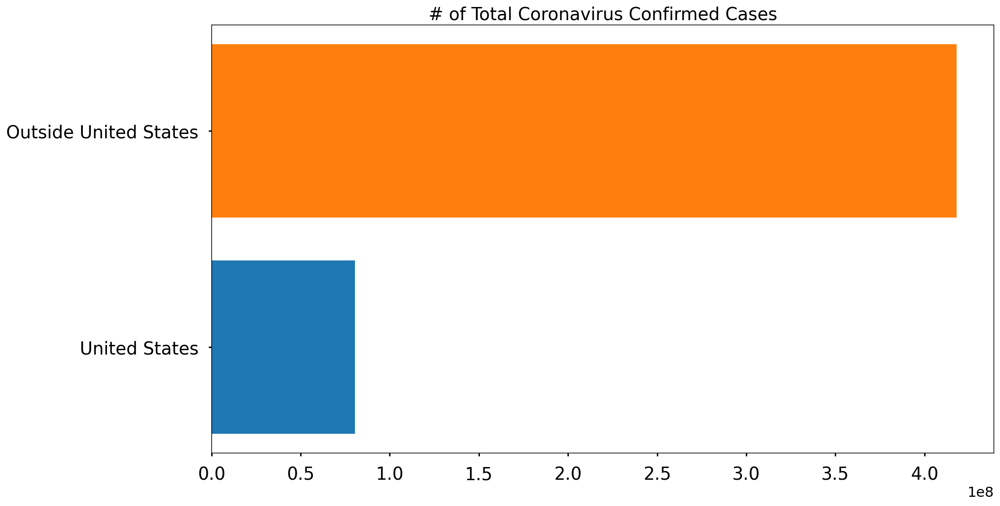

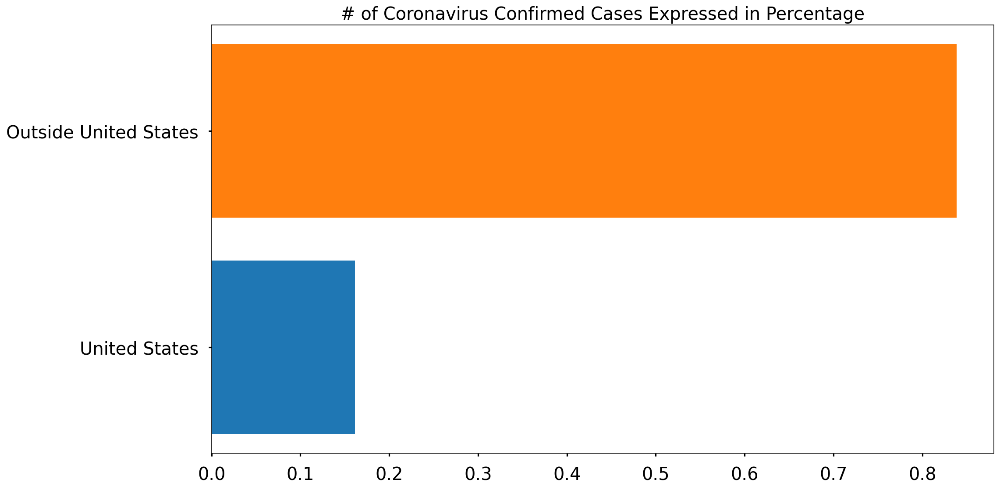

In [ ]:
total_world_cases = np.sum(country_confirmed_cases)
us_confirmed = latest_data[latest_data['Country_Region']=='US']['Confirmed'].sum()
outside_us_confirmed = total_world_cases - us_confirmed

plt.figure(figsize=(16, 9))
plt.barh('United States', us_confirmed)
plt.barh('Outside United States', outside_us_confirmed)
plt.title('# of Total Coronavirus Confirmed Cases', size=20)
plt.xticks(size=20)
plt.yticks(size=20)
plt.show()


plt.figure(figsize=(16, 9))
plt.barh('United States', us_confirmed/total_world_cases)
plt.barh('Outside United States', outside_us_confirmed/total_world_cases)
plt.title('# of Coronavirus Confirmed Cases Expressed in Percentage', size=20)
plt.xticks(size=20)
plt.yticks(size=20)
plt.show()

In [ ]:
print('Outside United States {} cases ({}%):'.format(outside_us_confirmed, np.round((outside_us_confirmed/total_world_cases)*100, 1)))
print('United States {} cases ({}%)'.format(us_confirmed, np.round((us_confirmed/total_world_cases)*100, 1)))
print('Total: {} cases'.format(total_world_cases))

Outside United States 418092562 cases (83.9%):
United States 80393928 cases (16.1%)
Total: 498486490 cases


In [ ]:
# Only show 10 countries with the most confirmed cases, the rest are grouped into the other category
visual_unique_countries = [] 
visual_confirmed_cases = []
others = np.sum(country_confirmed_cases[10:])

for i in range(len(country_confirmed_cases[:10])):
    visual_unique_countries.append(unique_countries[i])
    visual_confirmed_cases.append(country_confirmed_cases[i])
    
visual_unique_countries.append('Others')
visual_confirmed_cases.append(others)

In [ ]:
def plot_bar_graphs(x, y, title):
    plt.figure(figsize=(16, 12))
    plt.barh(x, y)
    plt.title(title, size=20)
    plt.xticks(size=20)
    plt.yticks(size=20)
    plt.show()
    
# good for a lot x values 
def plot_bar_graphs_tall(x, y, title):
    plt.figure(figsize=(19, 18))
    plt.barh(x, y)
    plt.title(title, size=25)
    plt.xticks(size=25)
    plt.yticks(size=25)
    plt.show()


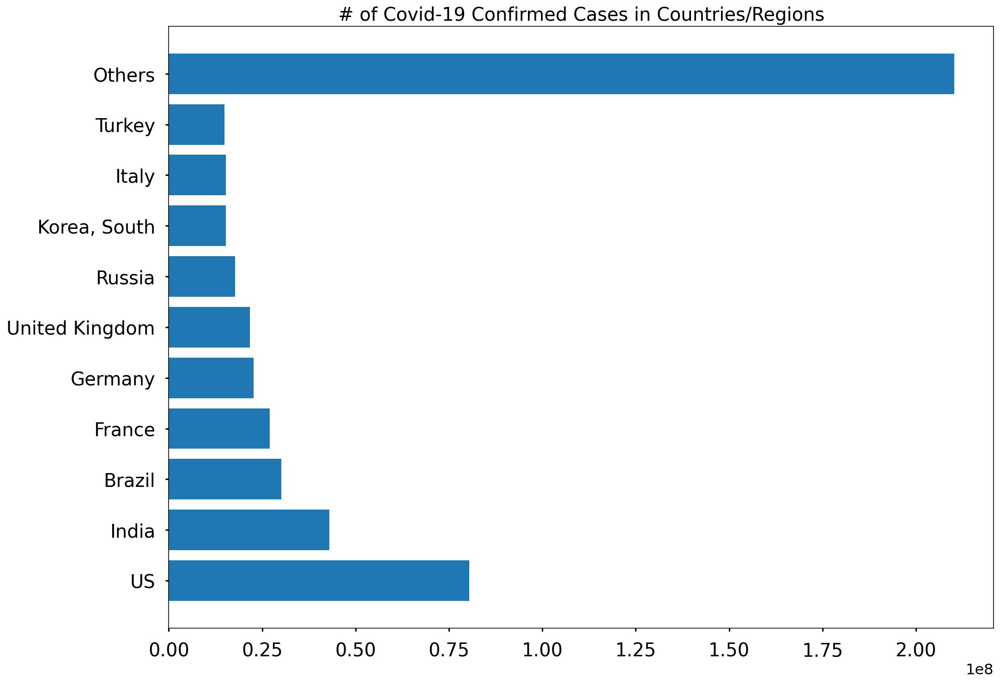

In [ ]:
plot_bar_graphs(visual_unique_countries, visual_confirmed_cases, '# of Covid-19 Confirmed Cases in Countries/Regions')

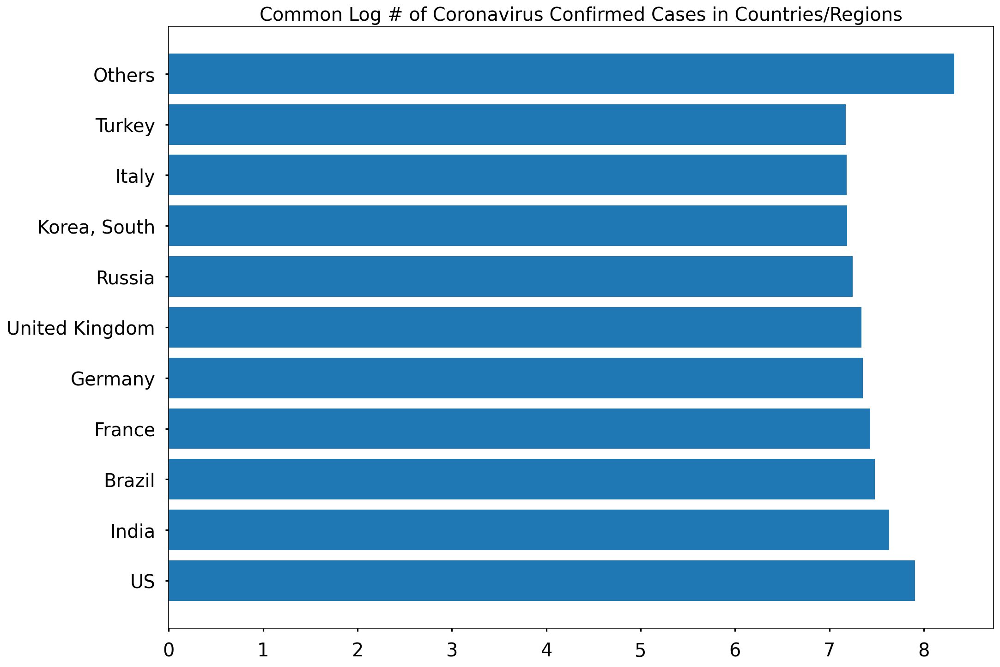

In [ ]:
log_country_confirmed_cases = [math.log10(i) for i in visual_confirmed_cases]
plot_bar_graphs(visual_unique_countries, log_country_confirmed_cases, 'Common Log # of Coronavirus Confirmed Cases in Countries/Regions')

In [ ]:


# Only show 10 provinces with the most confirmed cases, the rest are grouped into the other category
visual_unique_provinces = [] 
visual_confirmed_cases2 = []
others = np.sum(province_confirmed_cases[10:])
for i in range(len(province_confirmed_cases[:10])):
    visual_unique_provinces.append(unique_provinces[i])
    visual_confirmed_cases2.append(province_confirmed_cases[i])

visual_unique_provinces.append('Others')
visual_confirmed_cases2.append(others)



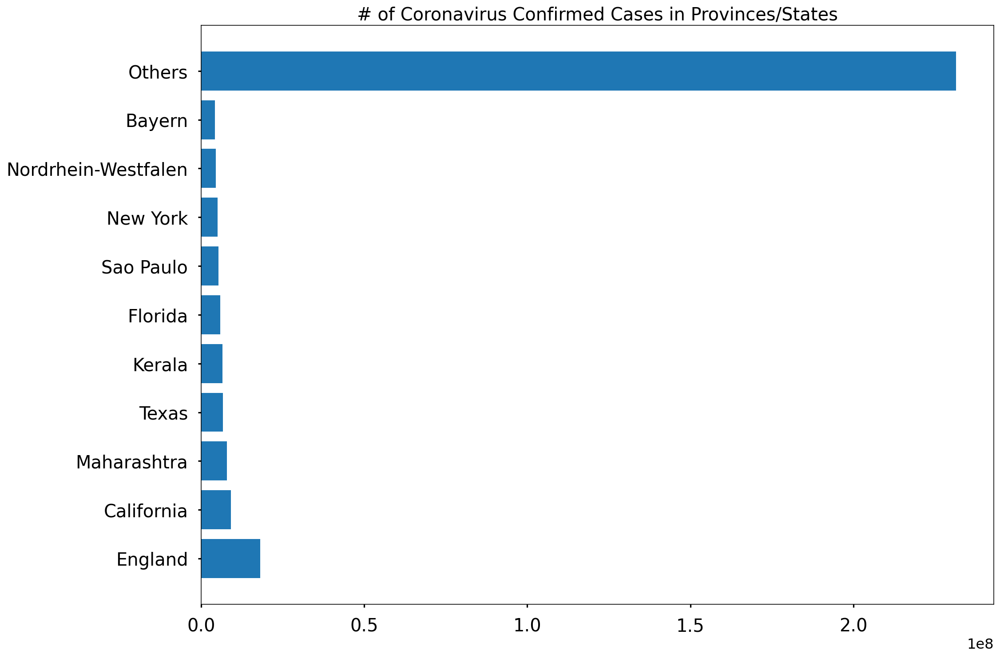

In [ ]:
plot_bar_graphs(visual_unique_provinces, visual_confirmed_cases2, '# of Coronavirus Confirmed Cases in Provinces/States')

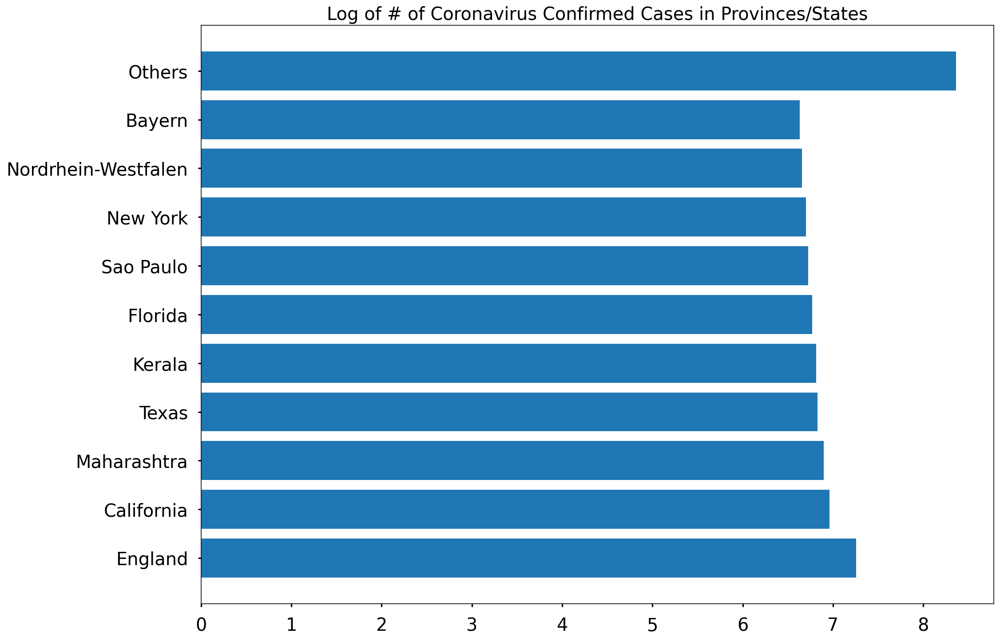

In [ ]:
log_province_confirmed_cases = [math.log10(i) for i in visual_confirmed_cases2]
plot_bar_graphs(visual_unique_provinces, log_province_confirmed_cases, 'Log of # of Coronavirus Confirmed Cases in Provinces/States')

In [ ]:
def plot_pie_charts(x, y, title):
    # more muted color 
    c = ['lightcoral', 'rosybrown', 'sandybrown', 'navajowhite', 'gold',
        'khaki', 'lightskyblue', 'turquoise', 'lightslategrey', 'thistle', 'pink']
    plt.figure(figsize=(20,15))
    plt.title(title, size=20)
    plt.pie(y, colors=c,shadow=True)
    plt.legend(x, loc='best', fontsize=12)
    plt.show()

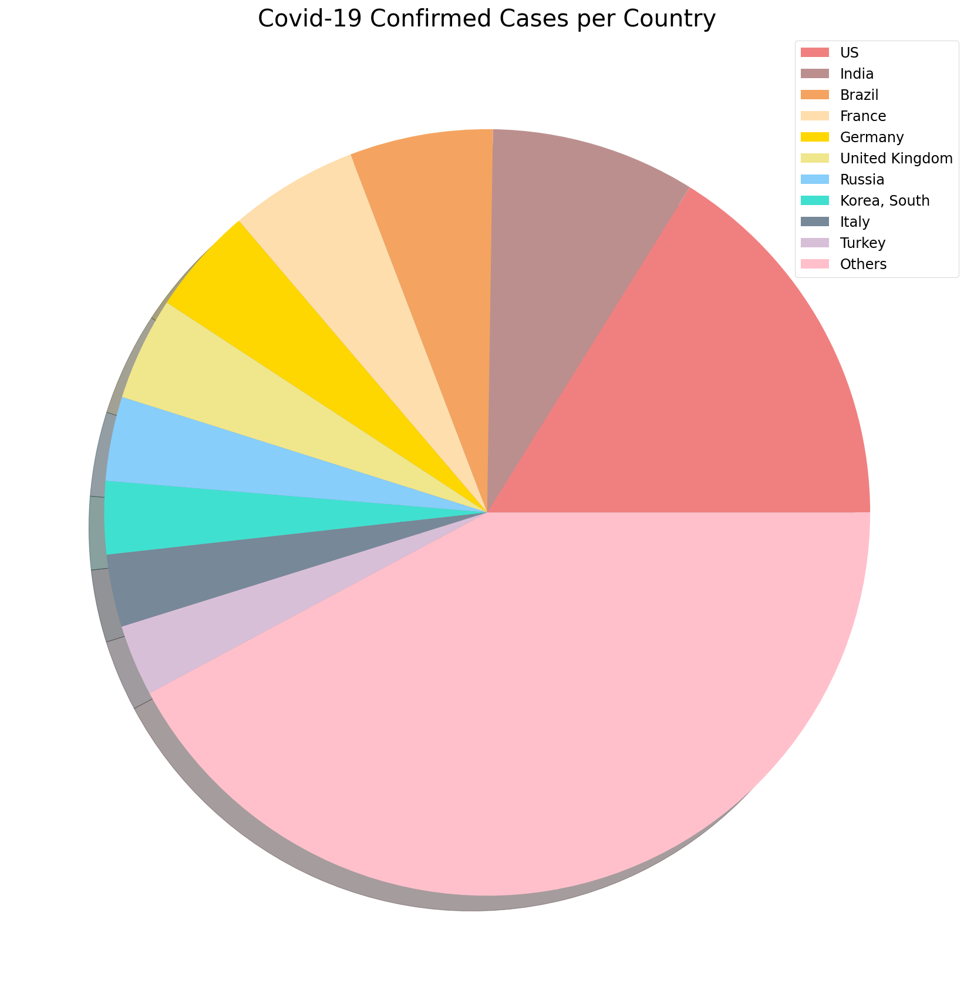

In [ ]:
plot_pie_charts(visual_unique_countries, visual_confirmed_cases, 'Covid-19 Confirmed Cases per Country')

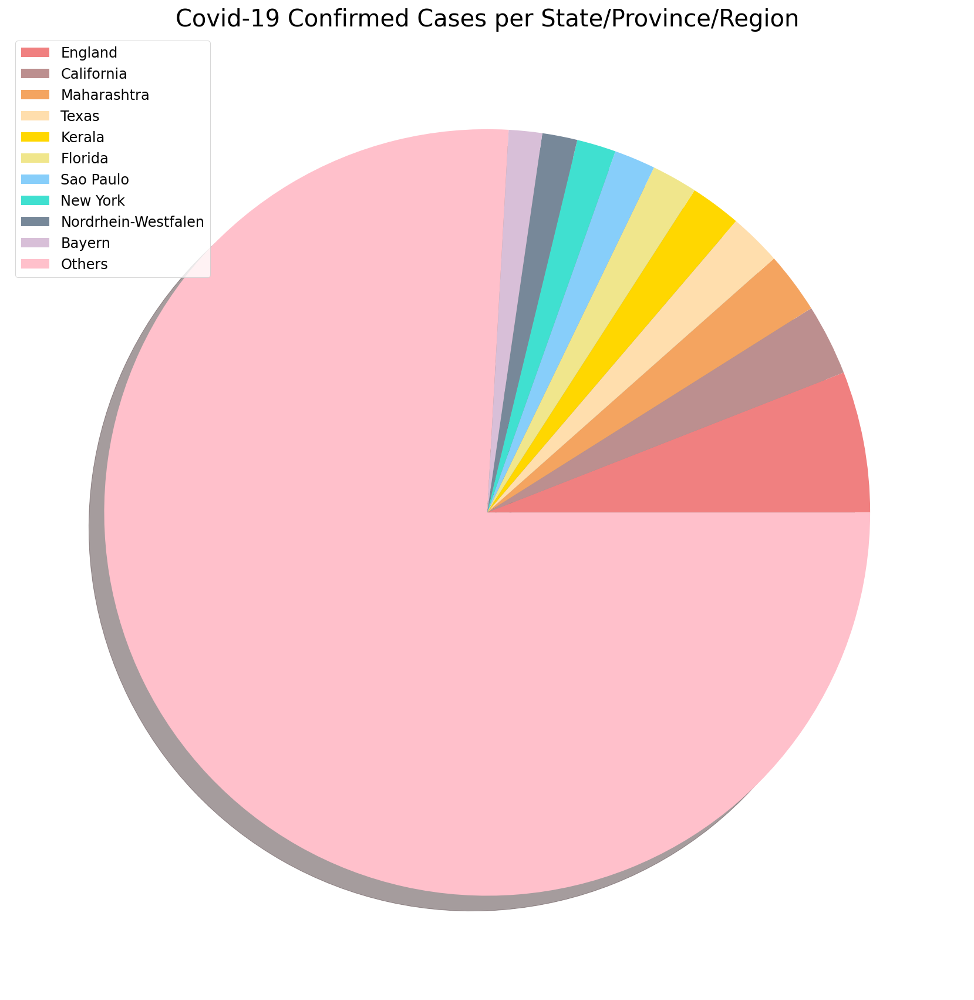

In [ ]:
plot_pie_charts(visual_unique_provinces, visual_confirmed_cases2, 'Covid-19 Confirmed Cases per State/Province/Region')

In [ ]:
# Plotting countries with regional data using a pie chart 

def plot_pie_country_with_regions(country_name, title):
    regions = list(latest_data[latest_data['Country_Region']==country_name]['Province_State'].unique())
    confirmed_cases = []
    no_cases = [] 
    for i in regions:
        cases = latest_data[latest_data['Province_State']==i]['Confirmed'].sum()
        if cases > 0:
            confirmed_cases.append(cases)
        else:
            no_cases.append(i)

    # remove areas with no confirmed cases
    for i in no_cases:
        regions.remove(i)

    # only show the top 5 states
    regions = [k for k, v in sorted(zip(regions, confirmed_cases), key=operator.itemgetter(1), reverse=True)]

    for i in range(len(regions)):
        confirmed_cases[i] = latest_data[latest_data['Province_State']==regions[i]]['Confirmed'].sum()  
    
    # additional province/state will be considered "others"
    
    if(len(regions)>5):
        regions_5 = regions[:5]
        regions_5.append('Others')
        confirmed_cases_5 = confirmed_cases[:5]
        confirmed_cases_5.append(np.sum(confirmed_cases[5:]))
        plot_pie_charts(regions_5,confirmed_cases_5, title)
    else:
        plot_pie_charts(regions,confirmed_cases, title)

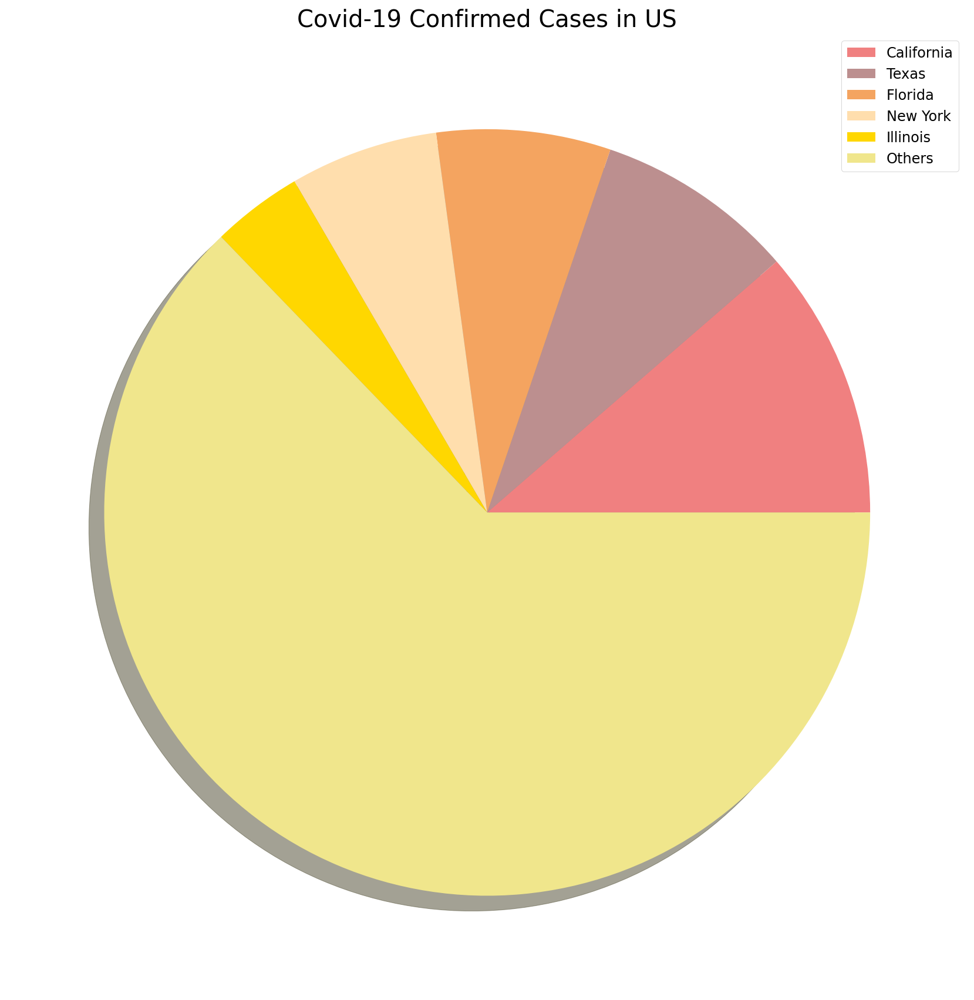

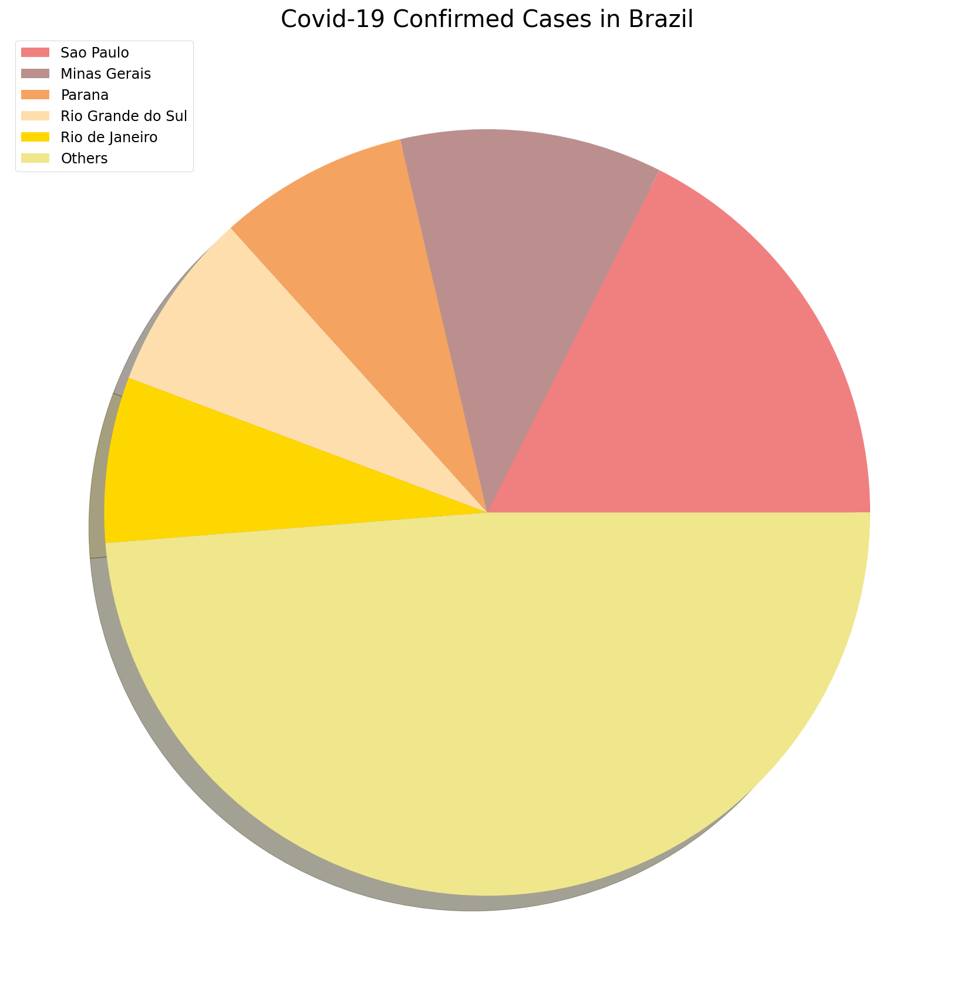

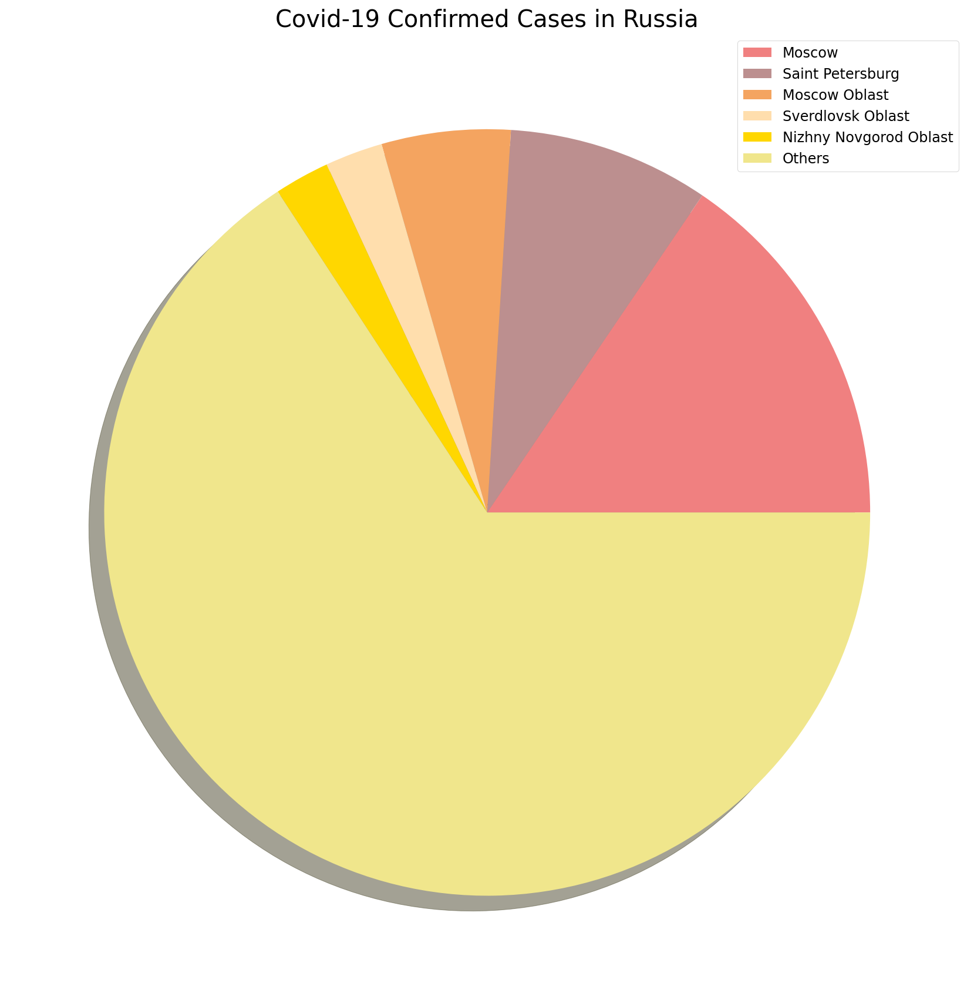

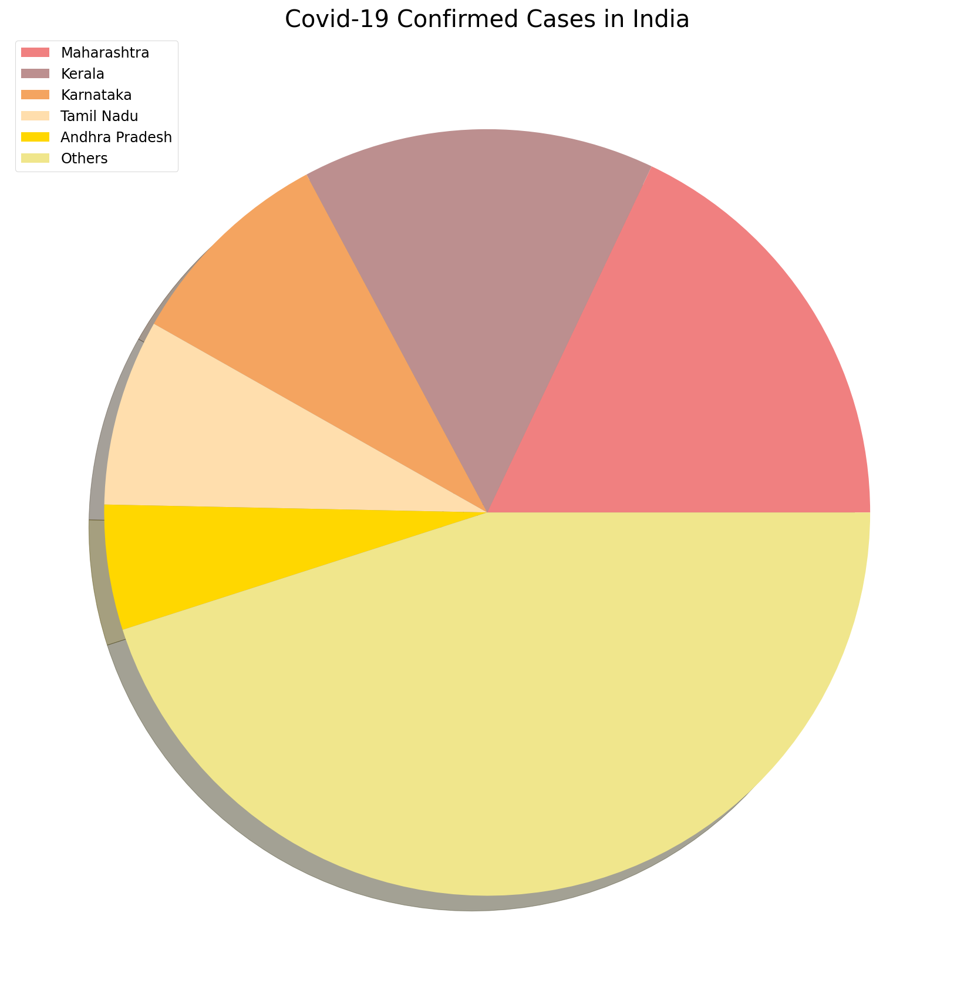

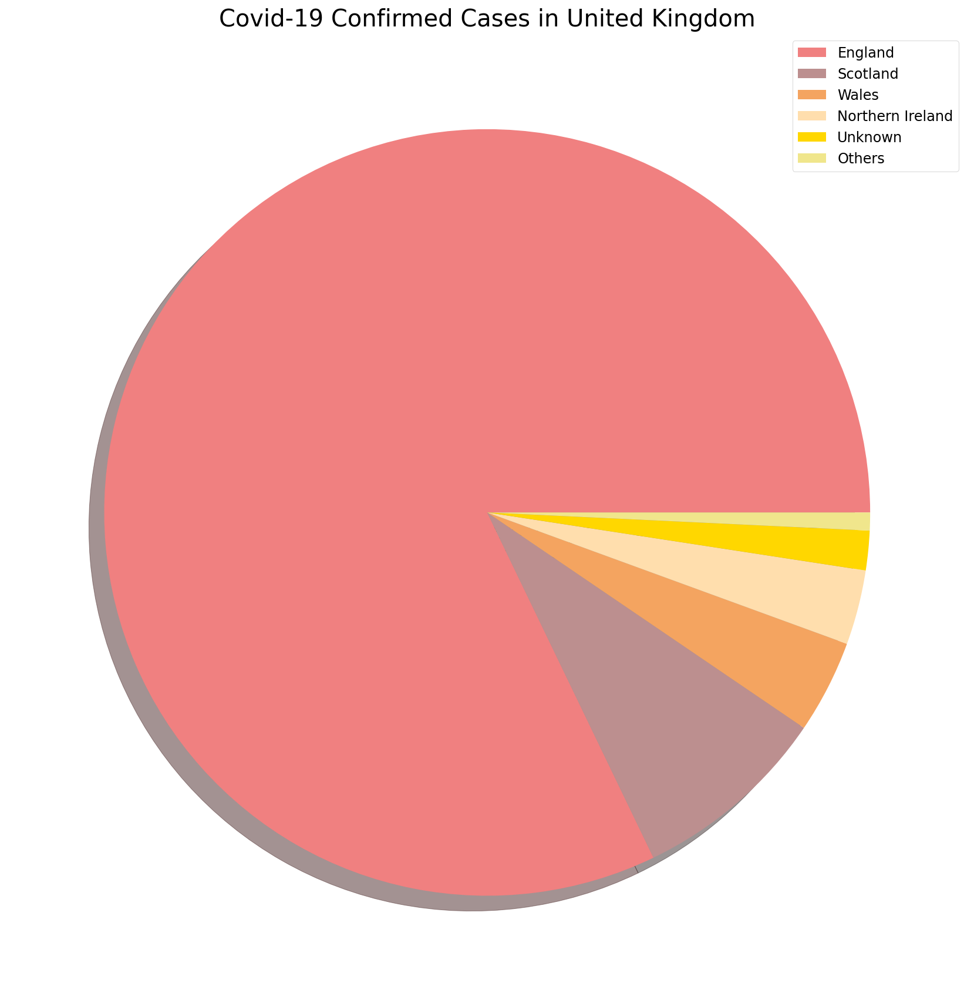

...

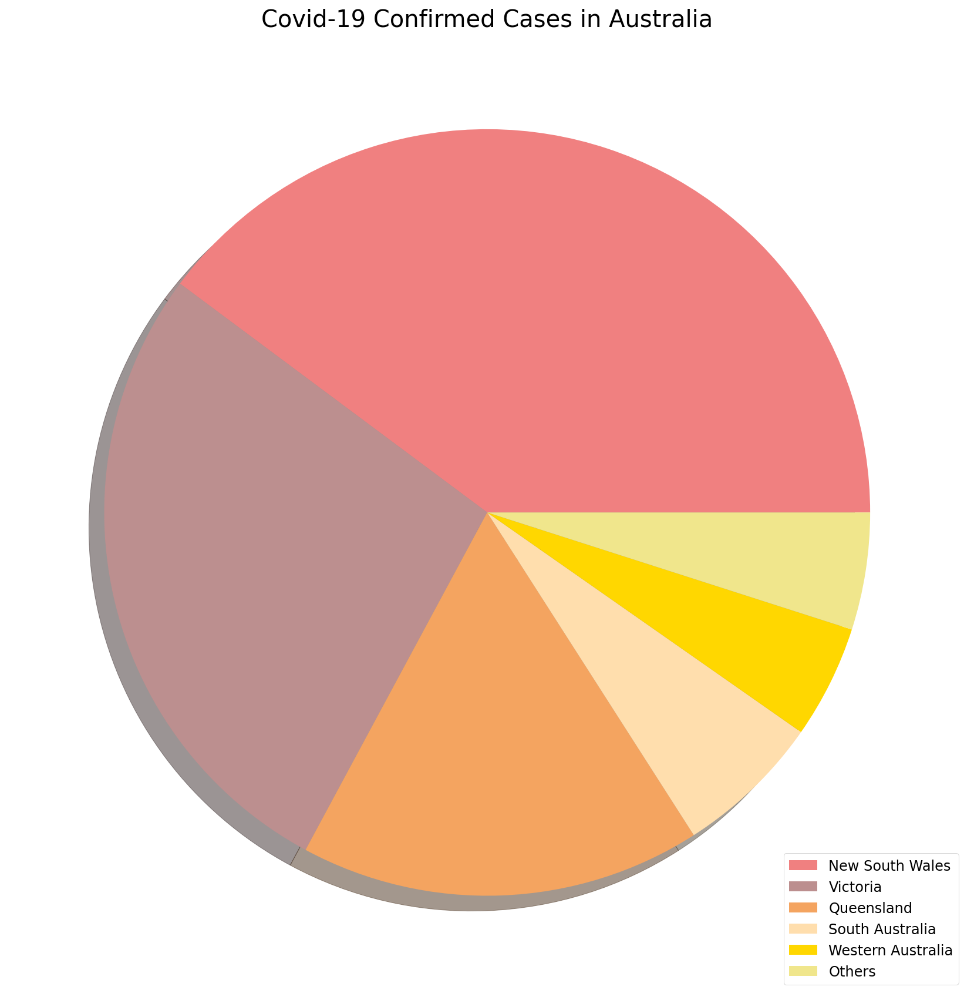

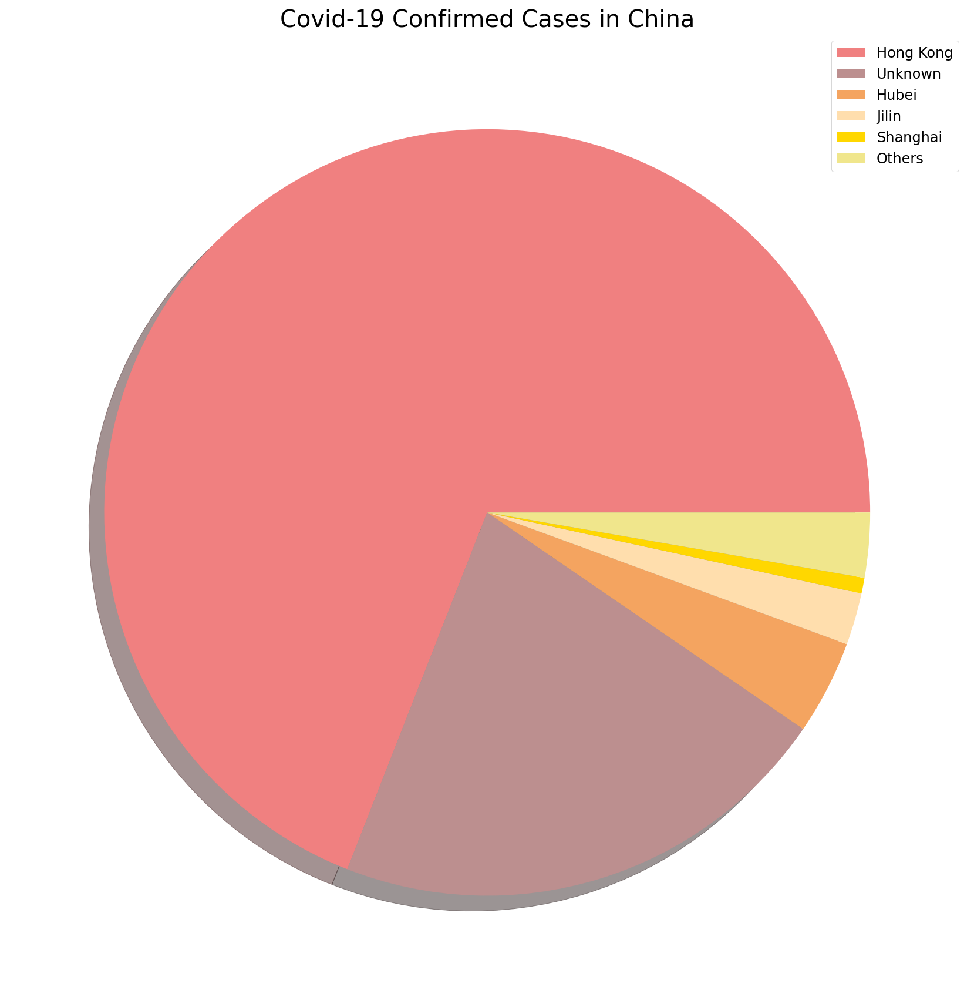

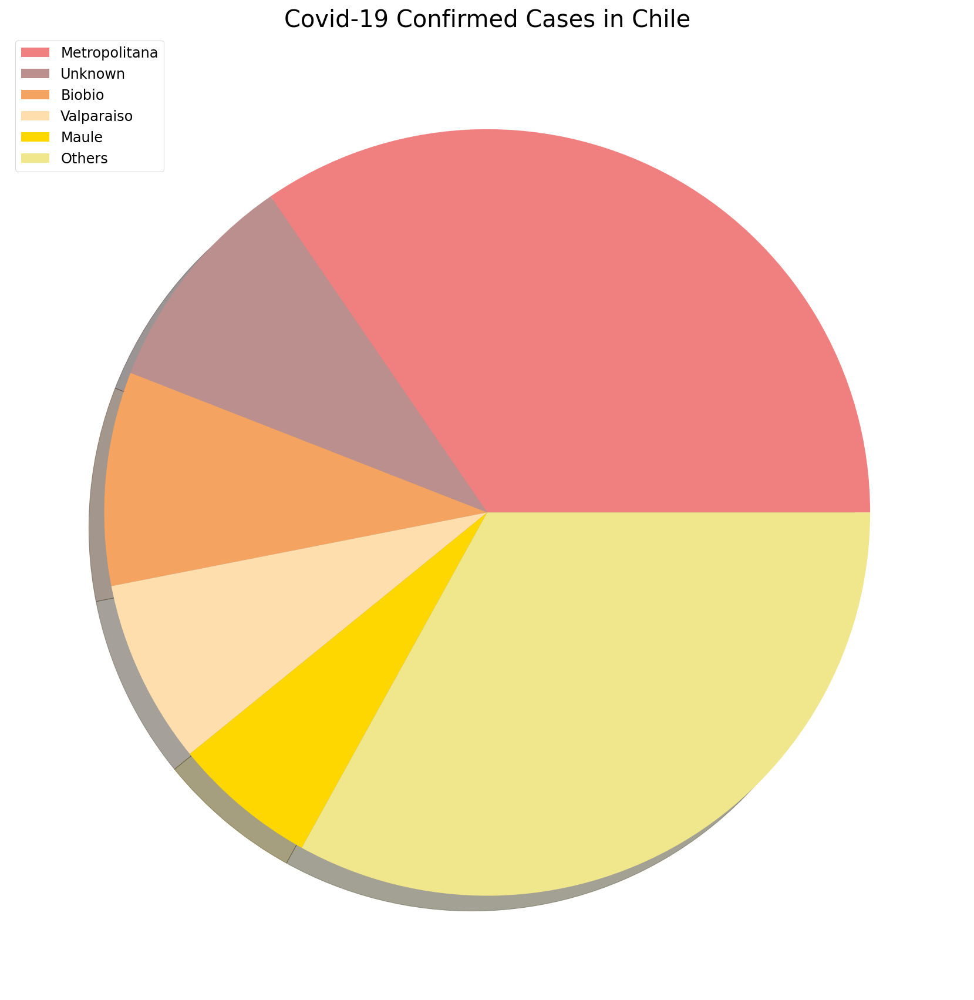

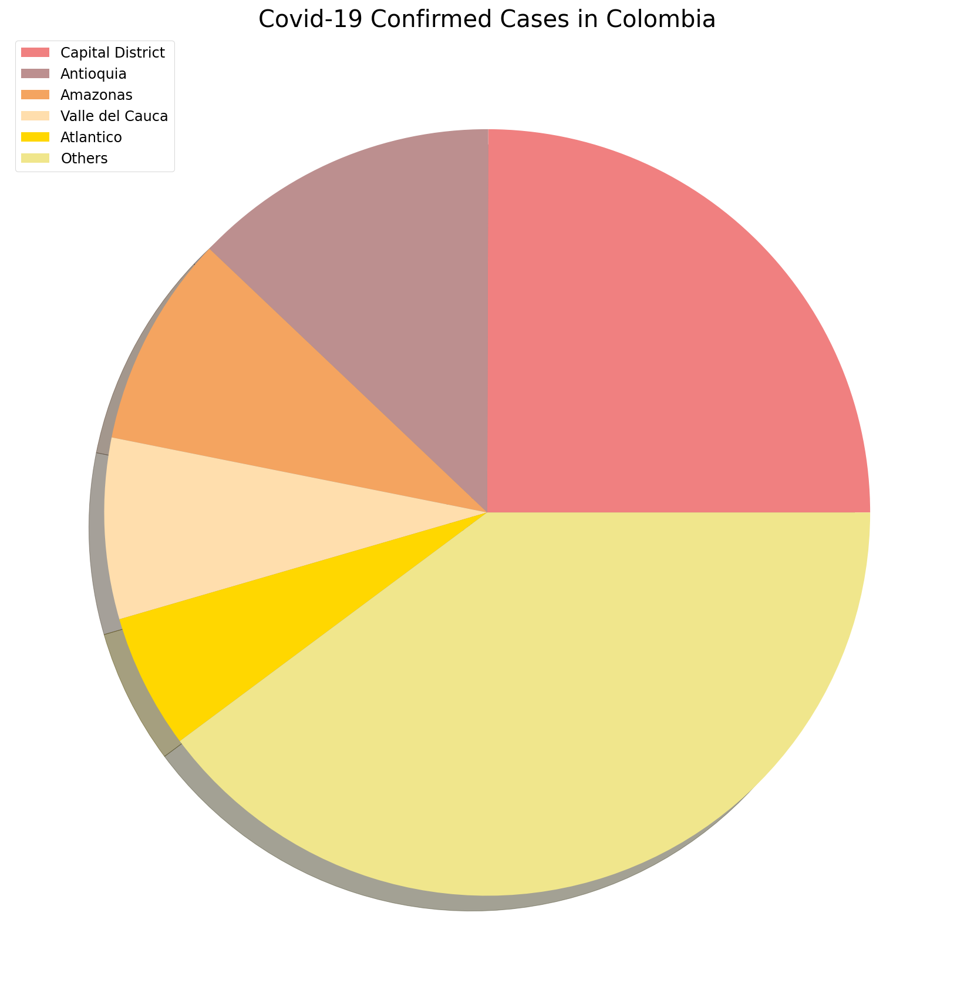

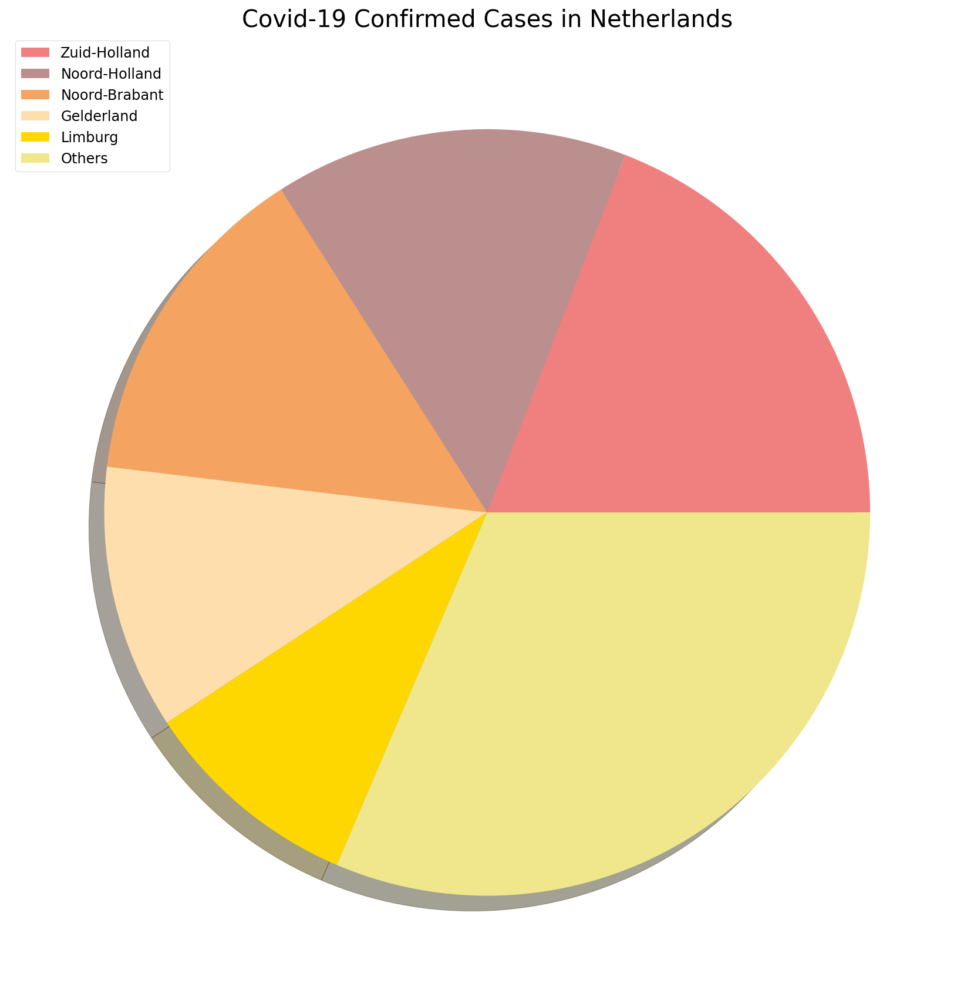

In [ ]:
pie_chart_countries = ['US', 'Brazil', 'Russia', 'India', 'United Kingdom', 'Italy', 'Germany', 'France', 'Spain', 'Peru', 'Mexico', 'Canada', 
                       'Australia', 'China', 'Chile', 'Colombia', 'Netherlands']

for i in pie_chart_countries:
    plot_pie_country_with_regions(i, 'Covid-19 Confirmed Cases in {}'.format(i))
